In [19]:
# df1 = pd.read_csv('./data/fruits1.csv')
# df2 = pd.read_csv('./data/fruits2.csv')

# df = pd.concat([df1, df2], axis=0, ignore_index=True) 
# df

,SALEDATE,WHSAL_NM,CMP_NM,PUM_NM,KIND_NM,DAN_NM,POJ_NM,LV_NM,SAN_NM,DANQ,QTY,COST,TOT_QTY,TOT_AMT
0,2020-12-31,서울가락도매,중앙청과,딸기,설향,kg,상자,특,경상남도 산청군,2.0,15838.0,17338.300290,31676.0,274604000
1,2020-12-31,서울가락도매,중앙청과,딸기,설향,kg,상자,특,충청남도 논산시,1.0,15421.0,9522.404513,15421.0,146845000
2,2020-12-31,부산반여도매,동부청과,딸기,육보,kg,상자,상,부산광역시,2.0,5996.0,30004.000000,11992.0,179903984
3,2020-12-31,서울가락도매,한국청과,딸기,설향,kg,상자,특,충청남도 공주시,2.0,4807.0,14628.562513,9614.0,70319500
4,2020-12-31,구리도매시장,구리청과,딸기,설향,kg,상자,등외,경기 구리시,2.0,4606.0,22562.092922,9212.0,103921000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6561651,2023-01-02,대구북부도매,대구중앙청과,파인애플,파인애플(수입),kg,상자,상,수입산,13.0,12.0,30000.000000,156.0,360000
6561652,2023-01-02,대구북부도매,효성청과,파인애플,파인애플(수입),kg,상자,등외,필리핀,12.0,6.0,31000.000000,72.0,186000
6561653,2023-01-02,대구북부도매,효성청과,파인애플,파인애플(수입),kg,상자,등외,필리핀,13.0,3.0,30000.000000,39.0,90000
6561654,2023-01-02,익산도매시장,익산원협(공),파인애플,기타파인애플,kg,상자,특,전북 완주군,12.0,2.0,27000.000000,24.0,54000


In [1]:
import matplotlib.pyplot as plt
plt.rc('font', family='Malgun Gothic') 
import matplotlib.cm as cm
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import math
import matplotlib as mpl
from datetime import datetime
from datetime import timedelta
import seaborn as sns
import folium
from folium.features import DivIcon
import json

In [2]:
df = pd.read_csv('../data/traintest.csv')
feature = df.columns[2:]
df

,date,요일,포도_거래량(kg),포도_가격(원/kg),망고_거래량(kg),망고_가격(원/kg),체리_거래량(kg),체리_가격(원/kg),레몬_거래량(kg),레몬_가격(원/kg),...,바나나_거래량(kg),바나나_가격(원/kg),복숭아_거래량(kg),복숭아_가격(원/kg),참다래(키위)_거래량(kg),참다래(키위)_가격(원/kg),자두_거래량(kg),자두_가격(원/kg),파인애플_거래량(kg),파인애플_가격(원/kg)
0,2020-01-01,수요일,80.00,4937.500000,0.0,0.000000,0.0,0.000000,0.00,0.000000,...,0.00,0.000000,0.0,0.000000,100.0,3000.000000,10.0,6000.000000,0.0,0.000000
1,2020-01-02,목요일,7307.40,4077.209404,1036.0,6583.976834,2040.0,13120.588235,366.60,3447.190398,...,75606.00,1582.209084,0.0,0.000000,2110.0,3163.744076,0.0,0.000000,9718.0,2395.114221
2,2020-01-03,금요일,123328.20,5584.640253,7548.0,7371.886592,6051.0,13410.180136,11814.56,3245.099860,...,920399.82,1188.720267,210.0,1328.571429,50769.0,4168.183340,0.0,0.000000,146887.0,1680.365859
3,2020-01-04,토요일,73000.50,6563.447237,3623.0,6660.024841,18010.4,10540.025208,6472.80,3461.097207,...,266685.50,1281.918365,3.0,3000.000000,33995.5,3211.666250,15.0,11933.333333,61085.0,1800.345420
4,2020-01-06,월요일,115448.70,6560.837151,3318.0,6565.355636,15627.0,10445.964037,14927.50,3277.203149,...,749667.70,1069.652941,0.0,0.000000,50674.3,2975.615253,6.0,4000.000000,126028.0,1702.494684
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1241,2023-12-26,화요일,182761.50,6943.016275,5346.5,8725.833910,1913.5,20614.962111,6693.40,4337.477814,...,363180.30,1715.946509,0.0,0.000000,38061.5,7753.385442,0.0,0.000000,90273.1,1987.074887
1242,2023-12-27,수요일,195870.15,7110.740508,34533.0,8283.285553,5177.0,21218.736720,19623.10,4514.194546,...,349302.12,1726.885167,0.0,0.000000,29585.3,6147.901154,0.0,0.000000,78907.3,1921.576077
1243,2023-12-28,목요일,221650.70,7485.121500,8025.0,8444.797508,6629.0,20222.378941,8713.50,4286.658633,...,452258.90,1760.928278,0.0,0.000000,25767.5,6059.467546,8.0,5000.000000,85765.8,2078.887622
1244,2023-12-29,금요일,240271.70,7204.242863,9107.5,7457.827066,7865.0,19862.110617,38718.80,4153.695879,...,534725.50,1590.033698,0.0,0.000000,27410.9,6190.015651,0.0,0.000000,125318.1,1818.099700


##### 1. 품목별 일별 가격&거래량

In [3]:
feature_price = []
for i in range(1,17):
  feature_price.append(feature[2*i-1])

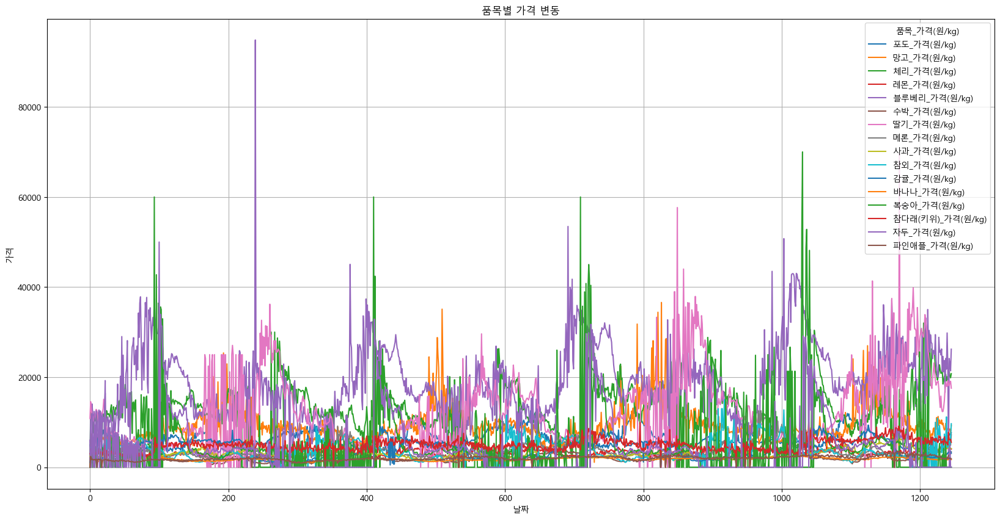

In [4]:
df[feature_price[:]] = df[feature_price[:]].apply(pd.to_numeric, errors='coerce')
df[feature_price[:]].plot(figsize=(20,10))

plt.title('품목별 가격 변동')
plt.xlabel('날짜')
plt.ylabel('가격')
plt.legend(title='품목_가격(원/kg)')
plt.grid(True)

plt.show()

In [5]:
feature_qty = []
for i in range(0,16):
  feature_qty.append(feature[2*i])

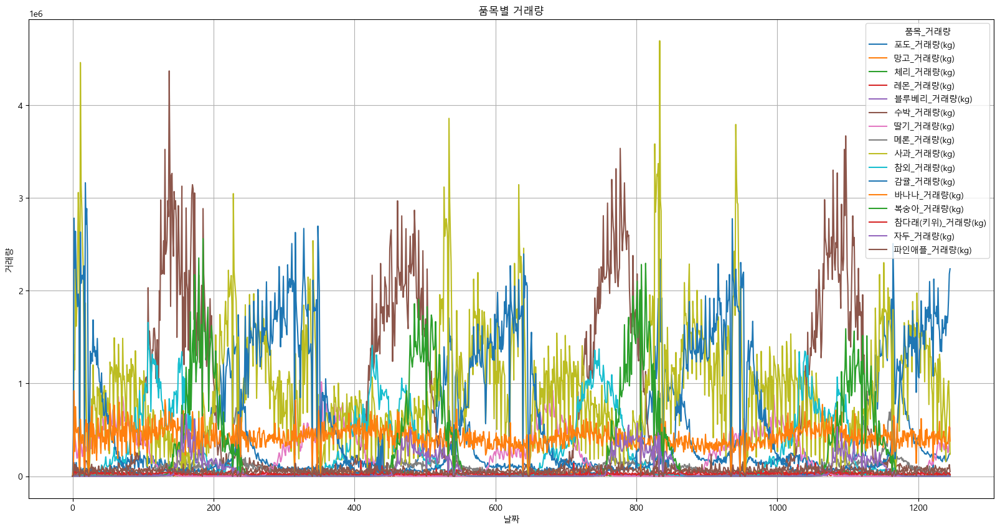

In [6]:
df[feature_qty[:]] = df[feature_qty[:]].apply(pd.to_numeric, errors='coerce')
df[feature_qty[:]].plot(figsize=(20,10))

plt.title('품목별 거래량')
plt.xlabel('날짜')
plt.ylabel('거래량')
plt.legend(title='품목_거래량')
plt.grid(True)

plt.show()

##### 2. 품목별 가격 분포

Text(0, 0.5, '가격(원/kg)')

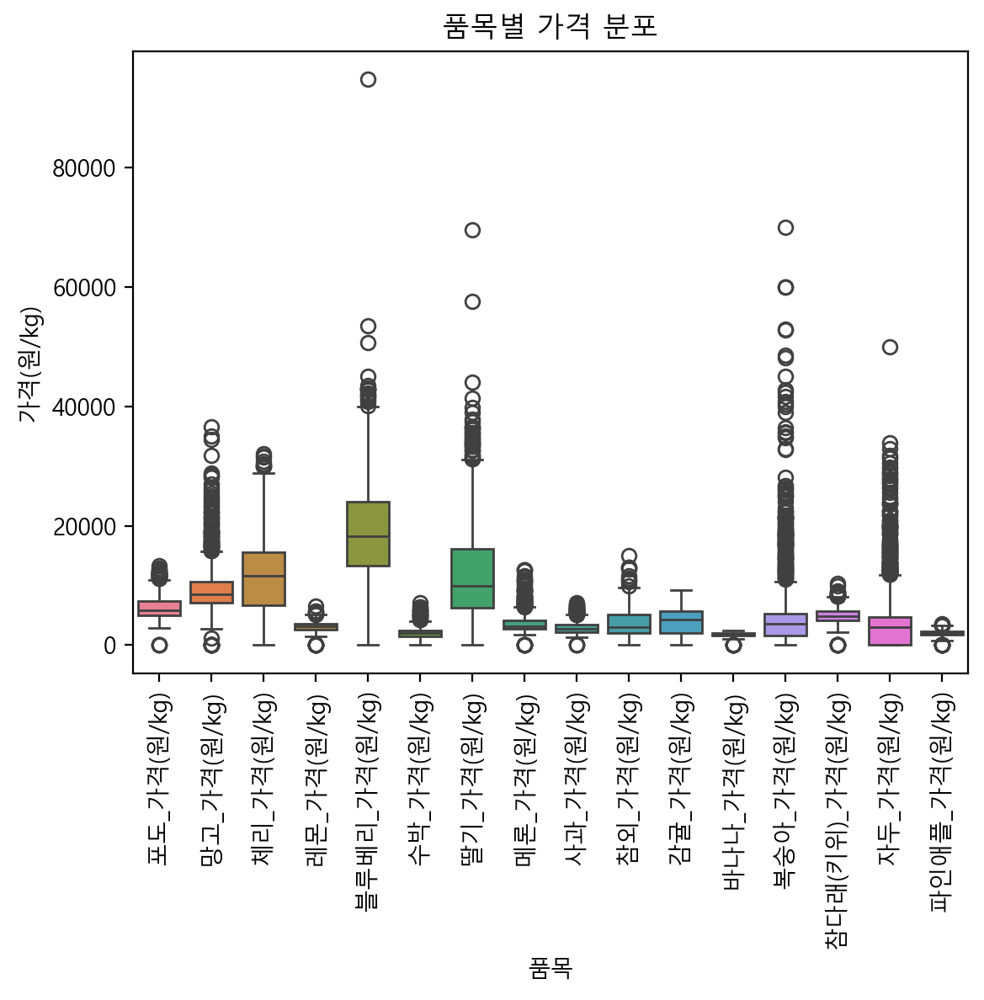

In [7]:
fig = plt.figure(dpi=200)
plt.xticks(rotation=90)
sns.boxplot(data=df[feature_price[:]])

plt.title('품목별 가격 분포')
plt.xlabel('품목')
plt.ylabel('가격(원/kg)')

##### 3. 월별 품목 순위

In [8]:
df['date'] = pd.to_datetime(df['date'])
df.set_index('date', inplace=True)
numeric_cols = df.select_dtypes(include='number')
df_monthly = numeric_cols.resample('ME').mean()

print(df_monthly.head())

               포도_거래량(kg)  포도_가격(원/kg)    망고_거래량(kg)  망고_가격(원/kg)  \
date                                                                
2020-01-31   62369.585714  6537.868295  13054.428571  5905.695451   
2020-02-29   48260.604000  6360.463177  24568.780000  5281.908261   
2020-03-31  117748.976923  4257.320246  23819.038462  6117.446619   
2020-04-30  166350.046154  4233.094666  18046.346154  7018.787000   
2020-05-31  142457.269231  4116.429812  12012.080769  8745.579005   

              체리_거래량(kg)   체리_가격(원/kg)    레몬_거래량(kg)  레몬_가격(원/kg)  \
date                                                                
2020-01-31   9355.610714  10062.455954   9034.481429  2658.544040   
2020-02-29   4536.680000  13338.011896   9963.735200  2863.363906   
2020-03-31   2264.153846  11256.707049  14866.033846  2489.809875   
2020-04-30    388.269231   5200.619284  15633.473077  2302.637157   
2020-05-31  19893.480769  14929.890563  13582.837692  2740.713057   

            블루베리_거래량(kg)  블루베리_가

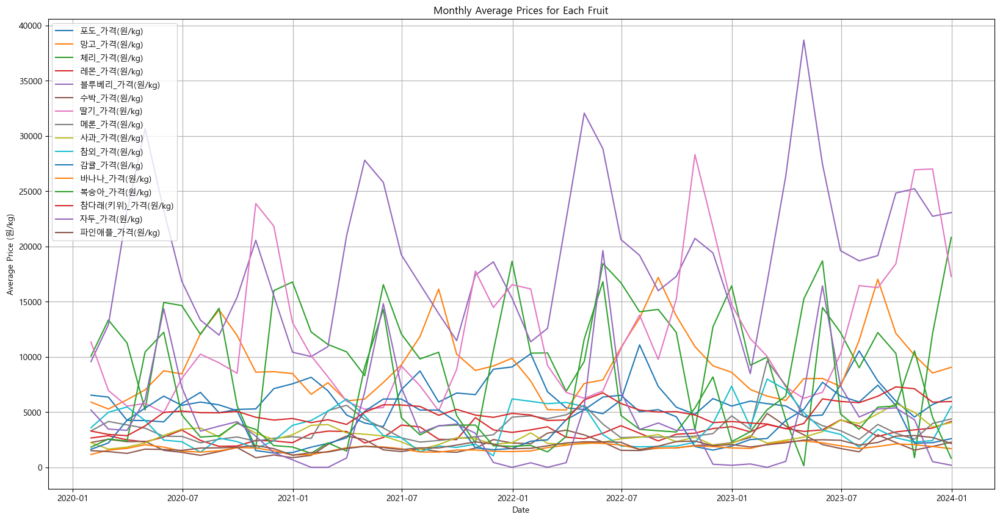

In [9]:
# 각 품목별로 월별 평균 가격을 그래프에 시각화
df_monthly = df_monthly.reset_index()
plt.figure(figsize=(20, 10))

for column in df_monthly.columns:
    if '가격' in column:
        plt.plot(df_monthly['date'], df_monthly[column], label=column)

plt.xlabel('Date')
plt.ylabel('Average Price (원/kg)')
plt.title('Monthly Average Prices for Each Fruit')
plt.legend(loc='upper left')
plt.grid(True)
plt.show()

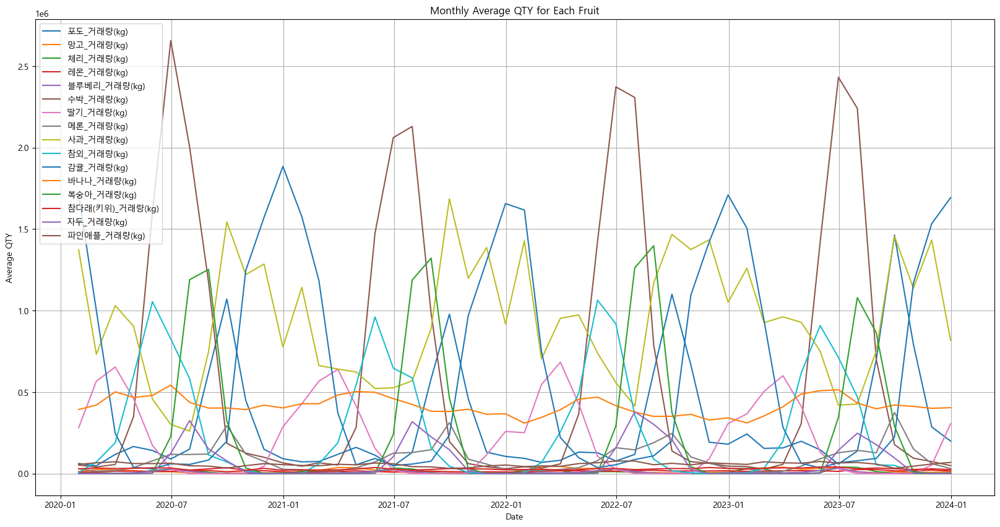

In [10]:
# 각 품목별로 월별 평균 거래량을 그래프에 시각화
df_monthly = df_monthly.reset_index()
plt.figure(figsize=(20, 10))

for column in df_monthly.columns:
    if '거래량' in column:
        plt.plot(df_monthly['date'], df_monthly[column], label=column)

plt.xlabel('Date')
plt.ylabel('Average QTY')
plt.title('Monthly Average QTY for Each Fruit')
plt.legend(loc='best')
plt.grid(True)
plt.show()

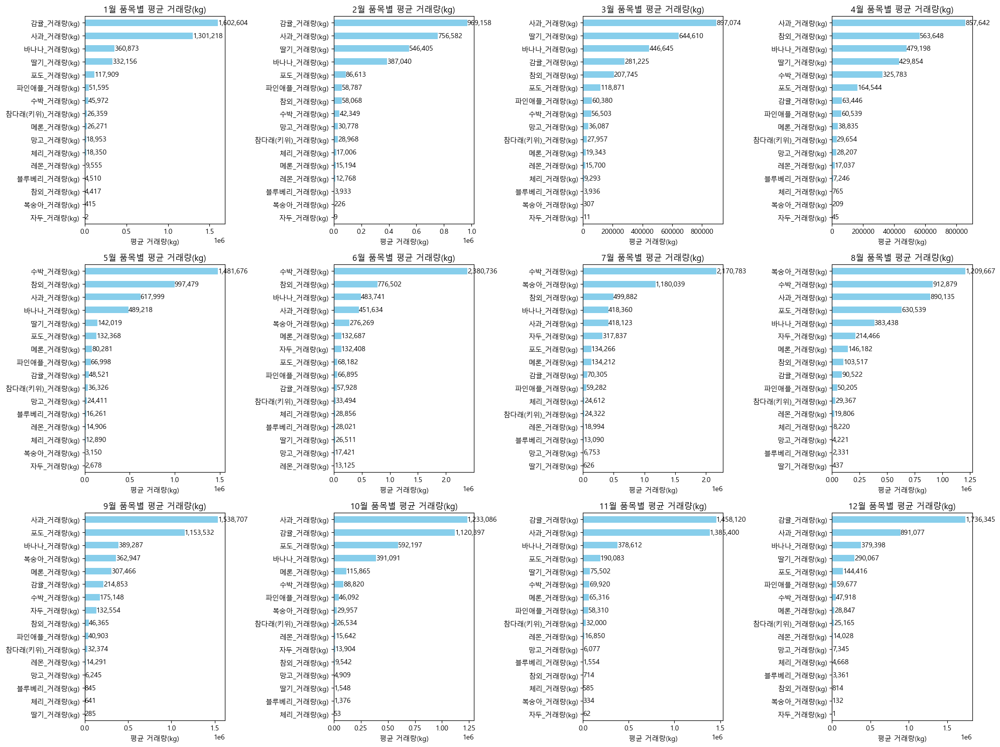

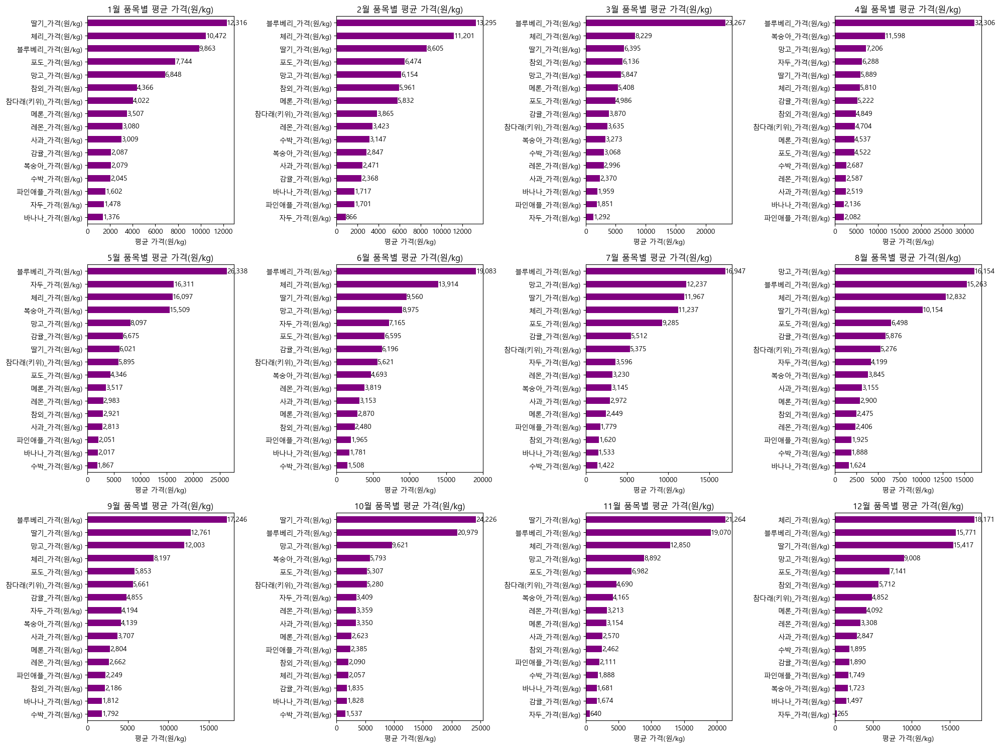

In [11]:
df_monthly['month'] = df_monthly['date'].dt.month
df_monthly_means = df_monthly.groupby('month').mean()

qty_cols = [col for col in df_monthly_means.columns if '거래량' in col]
price_cols = [col for col in df_monthly_means.columns if '가격' in col]

def add_values_on_bars(ax, spacing=5):
    for bar in ax.patches:
        _x = bar.get_width()
        _y = bar.get_y() + bar.get_height() / 2
        value = f'{bar.get_width():,.0f}'
        ax.text(_x + spacing, _y, value, va='center')

# 거래량 기준
fig, axes = plt.subplots(3, 4, figsize=(20, 15))
axes = axes.flatten()

for month in range(1, 13):
    ax = df_monthly_means.loc[month, qty_cols].sort_values().plot(kind='barh', ax=axes[month-1], color='skyblue')
    add_values_on_bars(ax)
    axes[month-1].set_title(f'{month}월 품목별 평균 거래량(kg)')
    axes[month-1].set_xlabel('평균 거래량(kg)')

plt.tight_layout()
plt.show()

# 가격 기준
fig, axes = plt.subplots(3, 4, figsize=(20, 15))
axes = axes.flatten()

for month in range(1, 13):
    ax = df_monthly_means.loc[month, price_cols].sort_values().plot(kind='barh', ax=axes[month-1], color='purple')
    add_values_on_bars(ax)
    axes[month-1].set_title(f'{month}월 품목별 평균 가격(원/kg)')
    axes[month-1].set_xlabel('평균 가격(원/kg)')

plt.tight_layout()
plt.show()

- 월별 Top3

거래량

C:\Users\USER\AppData\Local\Temp\ipykernel_126184\3396412685.py:5: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = cm.get_cmap('Set3', 3)


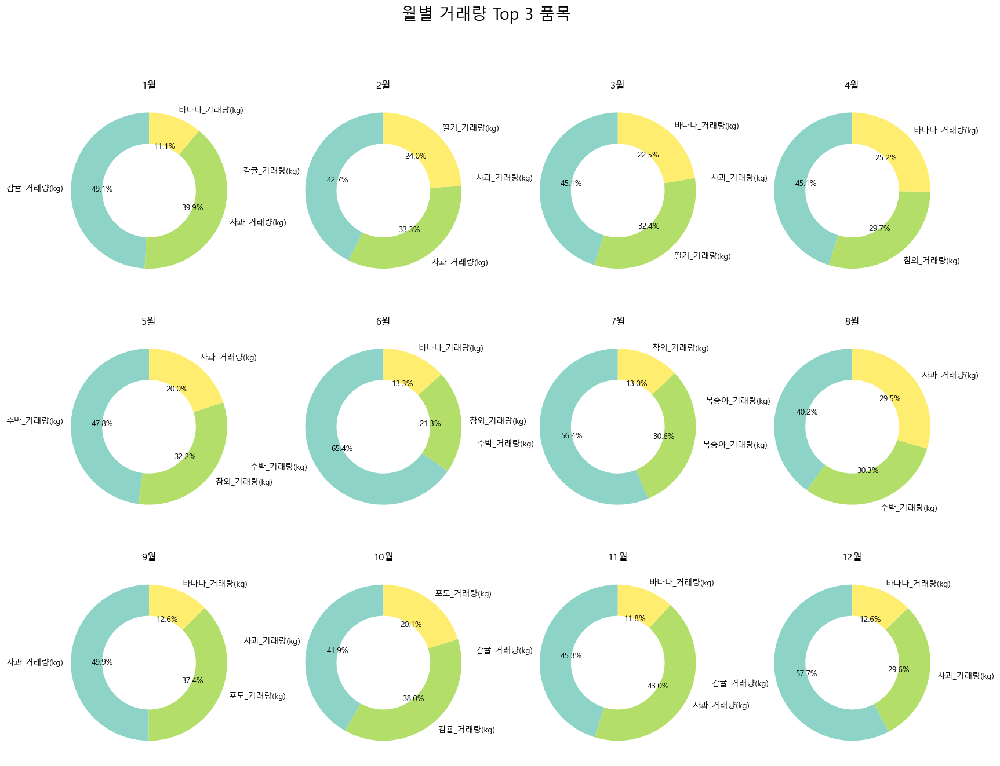

In [12]:
# qty_cols = [col for col in df_monthly.columns if '거래량' in col]
# price_cols = [col for col in df_monthly_means.columns if '가격' in col]

fig, axs = plt.subplots(3, 4, figsize=(20, 15))
colors = cm.get_cmap('Set3', 3)

for month in range(1, 13):
    df_month = df_monthly[df_monthly['month'] == month]
    top3_qty_items = df_month[qty_cols].sum().sort_values(ascending=False).head(3)

    ax = axs[(month-1) // 4, (month-1) % 4]
    ax.pie(top3_qty_items, labels=top3_qty_items.index, autopct='%1.1f%%', startangle=90, wedgeprops=dict(width=0.4), colors=colors(range(3)))
    ax.set_title(f'{month}월')

fig.suptitle('월별 거래량 Top 3 품목', fontsize=20)

plt.show()

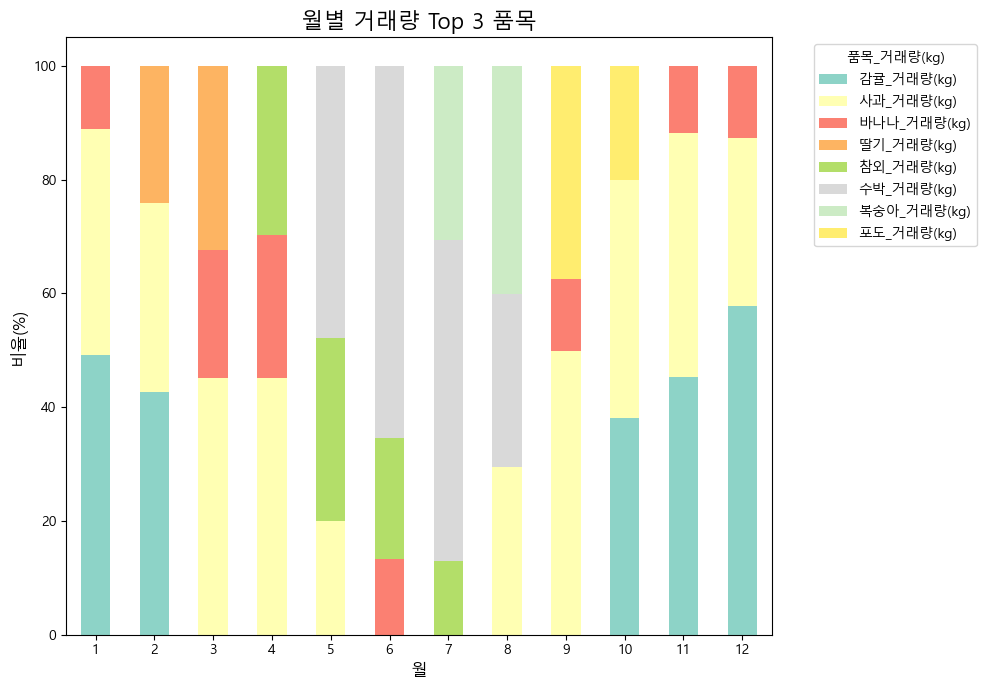

In [13]:
monthly_qty_top3 = pd.DataFrame()

for month in range(1, 13):
    df_month = df_monthly[df_monthly['month'] == month]
    top3_qty_items = df_month[qty_cols].sum().sort_values(ascending=False).head(3)
    monthly_qty_top3 = pd.concat([monthly_qty_top3, top3_qty_items.rename(month)], axis=1)

monthly_qty_top3.fillna(0, inplace=True)

monthly_qty_top3_ratio = monthly_qty_top3.div(monthly_qty_top3.sum(axis=0), axis=1) * 100

ax = monthly_qty_top3_ratio.T.plot(kind='bar', stacked=True, figsize=(10, 7), colormap='Set3')

plt.title('월별 거래량 Top 3 품목', fontsize=16)
plt.xlabel('월', fontsize=12)
plt.ylabel('비율(%)', fontsize=12)
plt.legend(title='품목_거래량(kg)', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.xticks(rotation=0)
plt.tight_layout()
plt.show()

단가

C:\Users\USER\AppData\Local\Temp\ipykernel_126184\52199708.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = cm.get_cmap('Set3', 3)


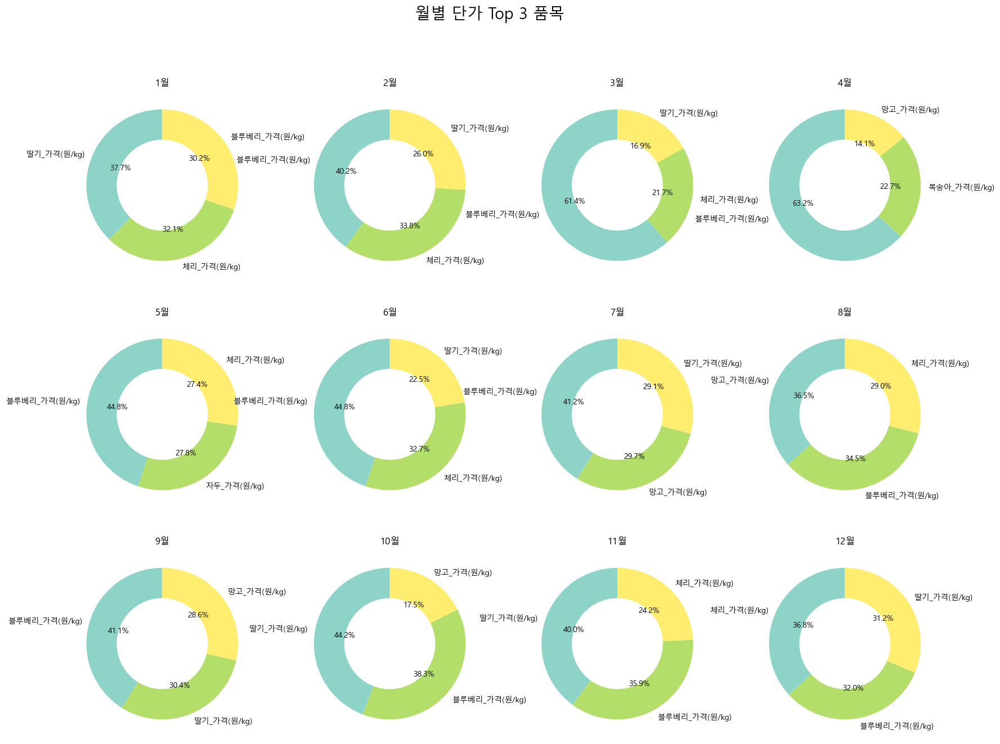

In [14]:
fig, axs = plt.subplots(3, 4, figsize=(20, 15))
colors = cm.get_cmap('Set3', 3)

for month in range(1, 13):
    df_month = df_monthly[df_monthly['month'] == month]
    top3_price_items = df_month[price_cols].sum().sort_values(ascending=False).head(3)

    ax = axs[(month-1) // 4, (month-1) % 4]
    ax.pie(top3_price_items, labels=top3_price_items.index, autopct='%1.1f%%', startangle=90, wedgeprops=dict(width=0.4), colors=colors(range(3)))
    ax.set_title(f'{month}월')

fig.suptitle('월별 단가 Top 3 품목', fontsize=20)

plt.show()

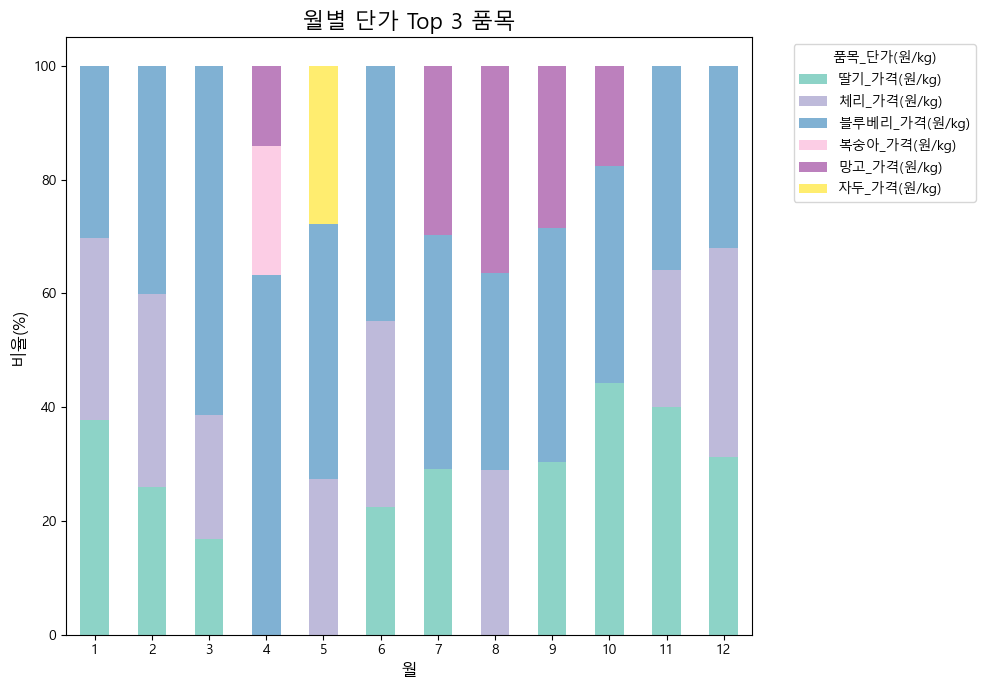

In [15]:
monthly_price_top3 = pd.DataFrame()

for month in range(1, 13):
    df_month = df_monthly[df_monthly['month'] == month]
    top3_price_items = df_month[price_cols].sum().sort_values(ascending=False).head(3)
    monthly_price_top3 = pd.concat([monthly_price_top3, top3_price_items.rename(month)], axis=1)

monthly_price_top3.fillna(0, inplace=True)

monthly_price_top3_ratio = monthly_price_top3.div(monthly_price_top3.sum(axis=0), axis=1) * 100

ax = monthly_price_top3_ratio.T.plot(kind='bar', stacked=True, figsize=(10, 7), colormap='Set3')

plt.title('월별 단가 Top 3 품목', fontsize=16)
plt.xlabel('월', fontsize=12)
plt.ylabel('비율(%)', fontsize=12)
plt.legend(title='품목_단가(원/kg)', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.xticks(rotation=0)
plt.tight_layout()
plt.show()

- 월별 Top5

거래량

C:\Users\USER\AppData\Local\Temp\ipykernel_126184\4025331891.py:7: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('tab20', len(unique_items))


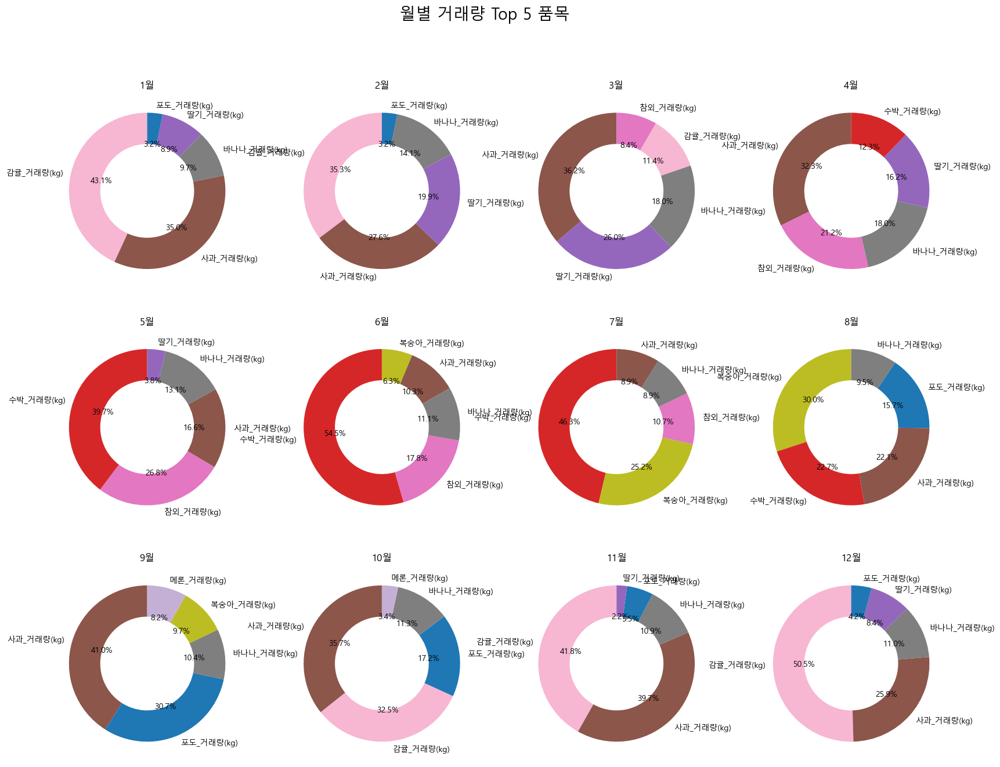

In [16]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm

cols = [col for col in df_monthly.columns if '거래량' in col]

unique_items = df_monthly[cols].columns
cmap = cm.get_cmap('tab20', len(unique_items))
color_map = {item: cmap(i) for i, item in enumerate(unique_items)}

fig, axs = plt.subplots(3, 4, figsize=(20, 15))

for month in range(1, 13):
    df_month = df_monthly[df_monthly['month'] == month]
    top_5_items = df_month[cols].sum().sort_values(ascending=False).head(5)
    item_colors = [color_map[item] for item in top_5_items.index]

    ax = axs[(month-1) // 4, (month-1) % 4]
    ax.pie(top_5_items, labels=top_5_items.index, autopct='%1.1f%%', 
           startangle=90, wedgeprops=dict(width=0.4), colors=item_colors)
    ax.set_title(f'{month}월')

fig.suptitle('월별 거래량 Top 5 품목', fontsize=20)
plt.show()


C:\Users\USER\AppData\Local\Temp\ipykernel_126184\826199316.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = cm.get_cmap('Set3', 5)


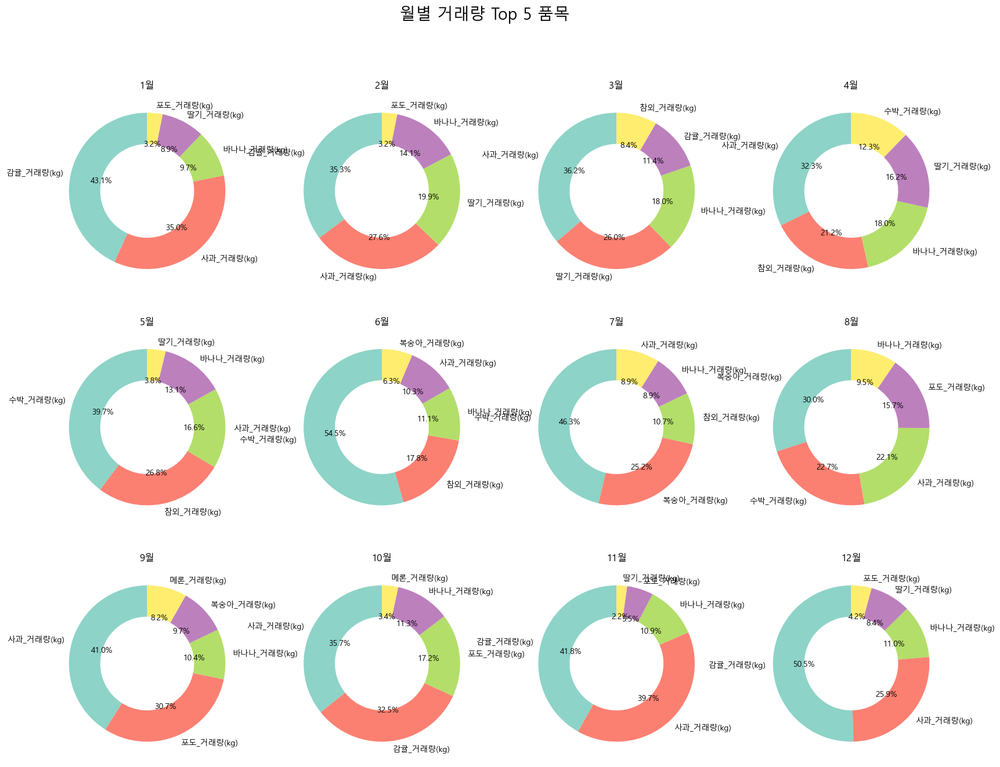

In [17]:
fig, axs = plt.subplots(3, 4, figsize=(20, 15))
colors = cm.get_cmap('Set3', 5)

for month in range(1, 13):
    df_month = df_monthly[df_monthly['month'] == month]
    top5_qty_items = df_month[qty_cols].sum().sort_values(ascending=False).head(5)

    ax = axs[(month-1) // 4, (month-1) % 4]
    ax.pie(top5_qty_items, labels=top5_qty_items.index, autopct='%1.1f%%', startangle=90, wedgeprops=dict(width=0.4), colors=colors(range(5)))
    ax.set_title(f'{month}월')

fig.suptitle('월별 거래량 Top 5 품목', fontsize=20)

plt.show()

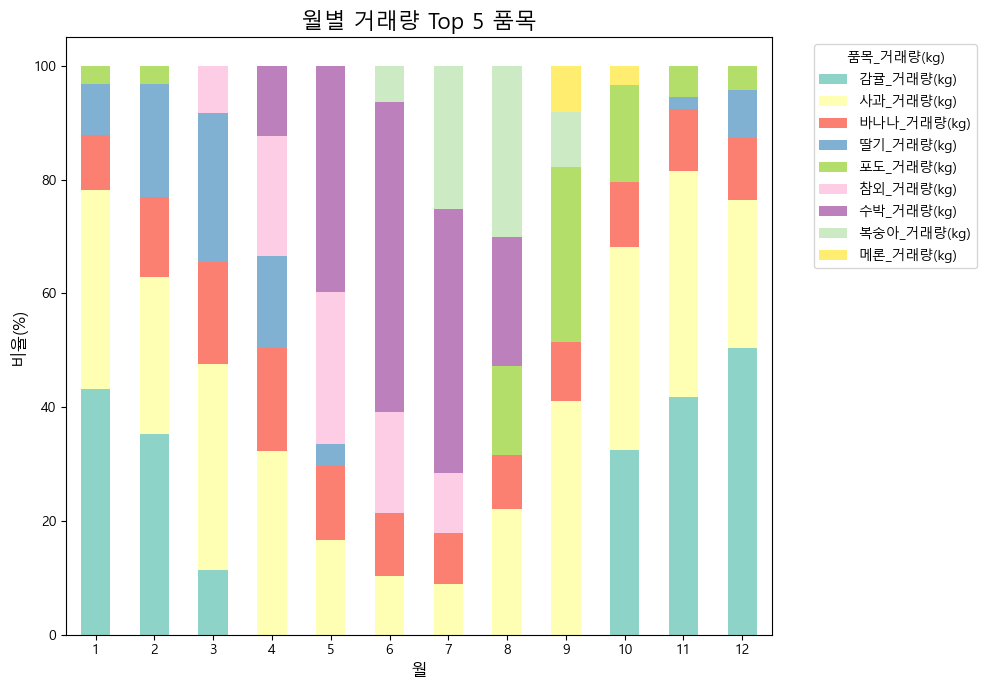

In [18]:
monthly_qty_top5 = pd.DataFrame()

for month in range(1, 13):
    df_month = df_monthly[df_monthly['month'] == month]
    top5_qty_items = df_month[qty_cols].sum().sort_values(ascending=False).head(5)
    monthly_qty_top5 = pd.concat([monthly_qty_top5, top5_qty_items.rename(month)], axis=1)

monthly_qty_top5.fillna(0, inplace=True)

monthly_qty_top5_ratio = monthly_qty_top5.div(monthly_qty_top5.sum(axis=0), axis=1) * 100

ax = monthly_qty_top5_ratio.T.plot(kind='bar', stacked=True, figsize=(10, 7), colormap='Set3')

plt.title('월별 거래량 Top 5 품목', fontsize=16)
plt.xlabel('월', fontsize=12)
plt.ylabel('비율(%)', fontsize=12)
plt.legend(title='품목_거래량(kg)', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.xticks(rotation=0)
plt.tight_layout()
plt.show()

단가

C:\Users\USER\AppData\Local\Temp\ipykernel_126184\2422296169.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = cm.get_cmap('Set3', 5)


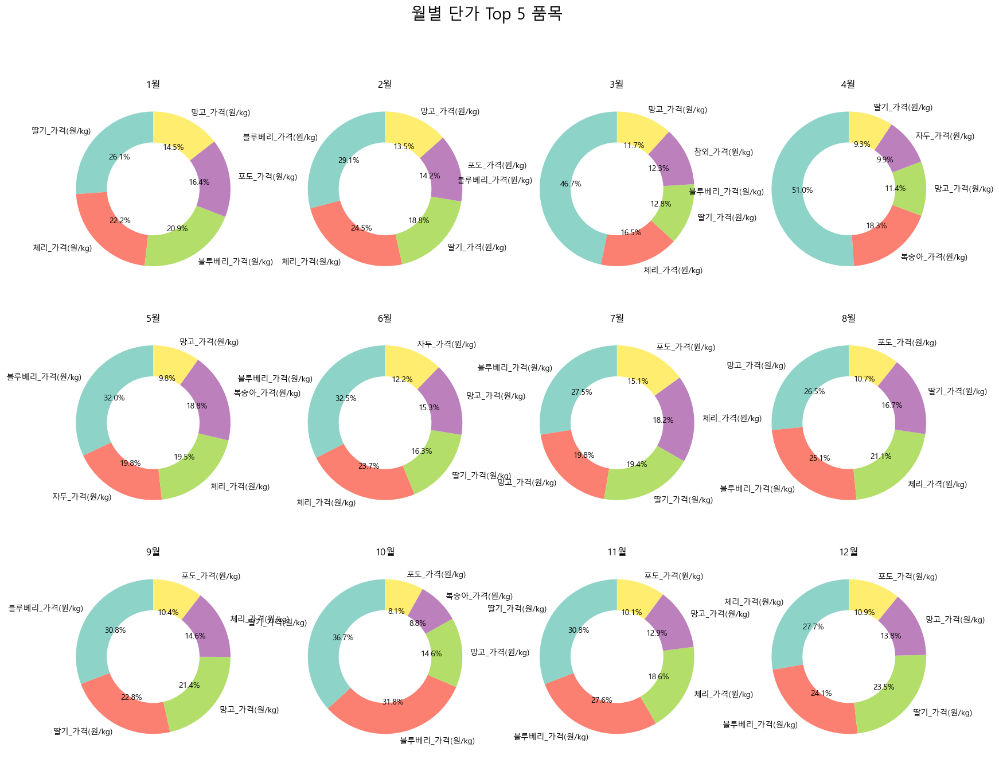

In [19]:
fig, axs = plt.subplots(3, 4, figsize=(20, 15))
colors = cm.get_cmap('Set3', 5)

for month in range(1, 13):
    df_month = df_monthly[df_monthly['month'] == month]
    top5_price_items = df_month[price_cols].sum().sort_values(ascending=False).head(5)

    ax = axs[(month-1) // 4, (month-1) % 4]
    ax.pie(top5_price_items, labels=top5_price_items.index, autopct='%1.1f%%', startangle=90, wedgeprops=dict(width=0.4), colors=colors(range(5)))
    ax.set_title(f'{month}월')

fig.suptitle('월별 단가 Top 5 품목', fontsize=20)

plt.show()

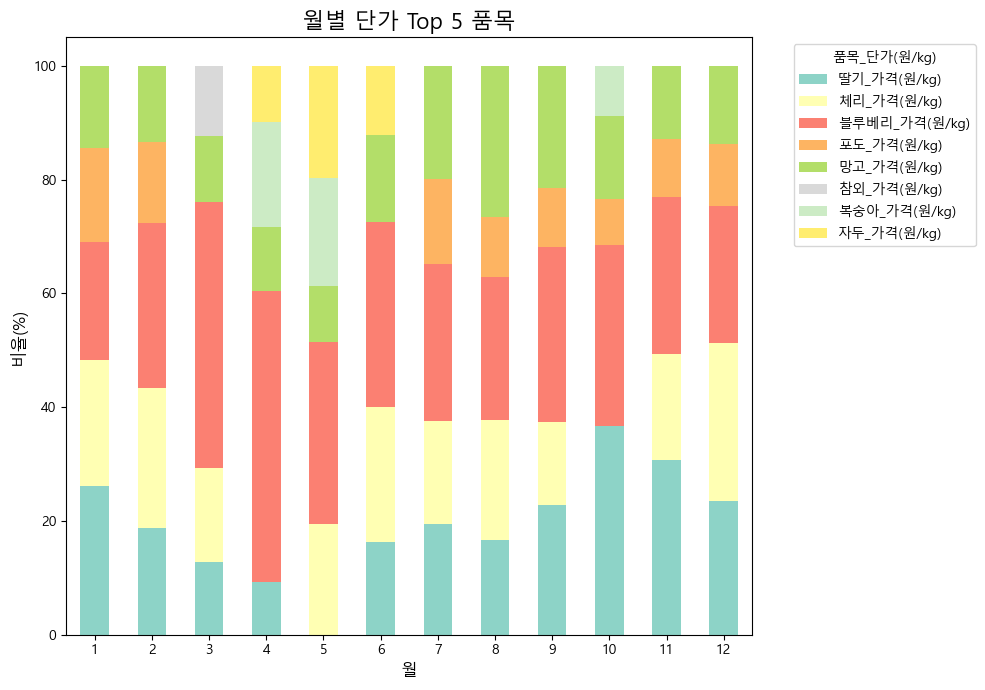

In [20]:
monthly_price_top5 = pd.DataFrame()

for month in range(1, 13):
    df_month = df_monthly[df_monthly['month'] == month]
    top5_price_items = df_month[price_cols].sum().sort_values(ascending=False).head(5)
    monthly_price_top5 = pd.concat([monthly_price_top5, top5_price_items.rename(month)], axis=1)

monthly_price_top5.fillna(0, inplace=True)

monthly_price_top5_ratio = monthly_price_top5.div(monthly_price_top5.sum(axis=0), axis=1) * 100

ax = monthly_price_top5_ratio.T.plot(kind='bar', stacked=True, figsize=(10, 7), colormap='Set3')

plt.title('월별 단가 Top 5 품목', fontsize=16)
plt.xlabel('월', fontsize=12)
plt.ylabel('비율(%)', fontsize=12)
plt.legend(title='품목_단가(원/kg)', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.xticks(rotation=0)
plt.tight_layout()
plt.show()

##### 4. 년도별 품목 순위

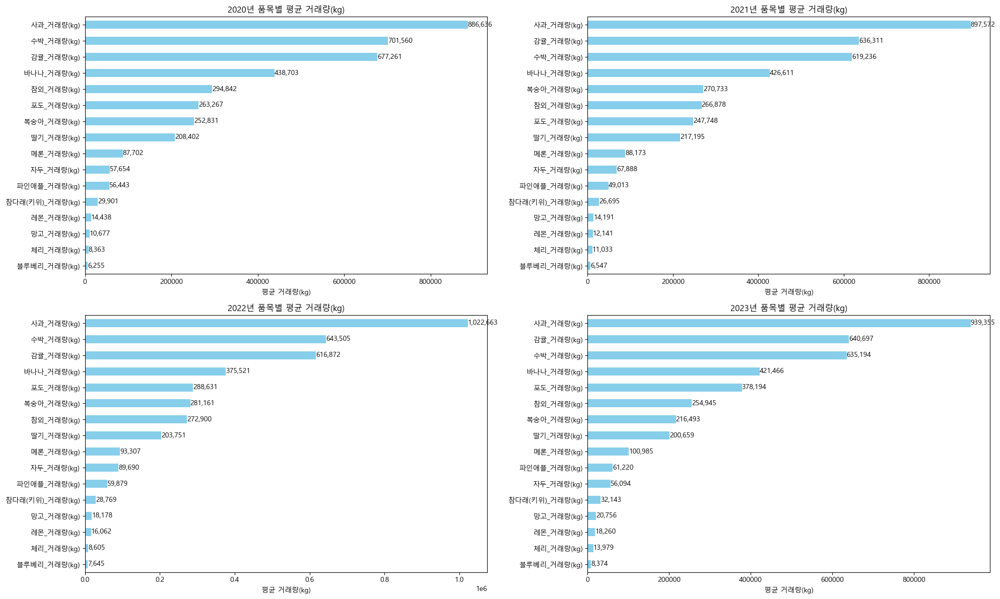

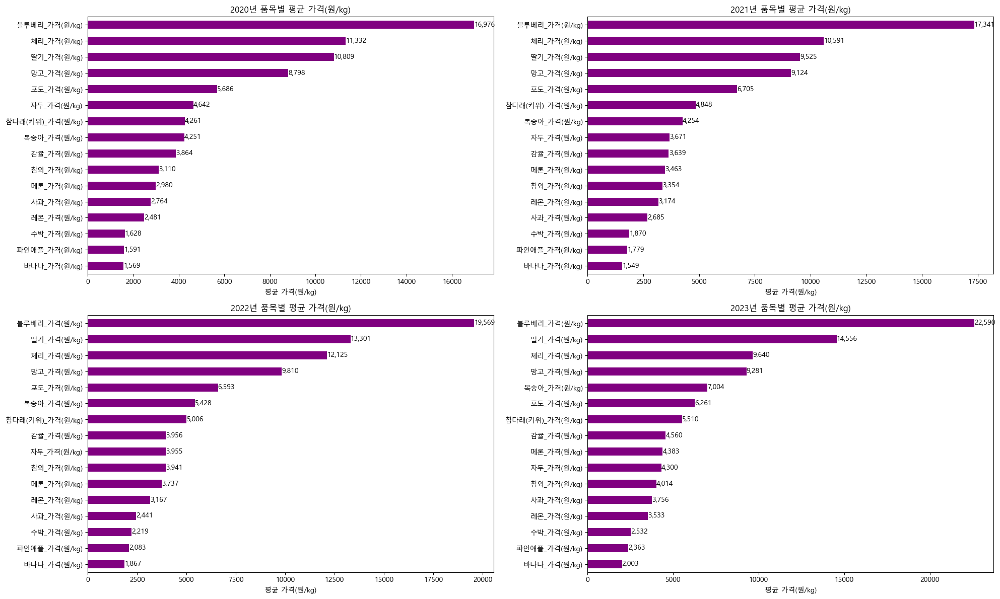

In [21]:
# 연도별 평균 계산
def calculate_yearly_mean(df, year):
    df_year = df[df['date'].dt.year == year]
    return df_year.drop(columns=['date']).mean()

years = [2020, 2021, 2022, 2023]
df_means = {year: calculate_yearly_mean(df_monthly, year) for year in years}

qty_cols = [col for col in df_means[2020].index if '거래량' in col]
price_cols = [col for col in df_means[2020].index if '가격' in col]

def add_values_on_bars(ax, spacing=5):
    for bar in ax.patches:
        _x = bar.get_x() + bar.get_width()
        _y = bar.get_y() + bar.get_height() / 2
        value = f'{bar.get_width():,.0f}'
        ax.text(_x + spacing, _y, value, va='center')

# 거래량 기준
fig, axes = plt.subplots(2, 2, figsize=(20, 12))
axes = axes.flatten()

for i, year in enumerate(years):
    ax = df_means[year][qty_cols].sort_values().plot(kind='barh', ax=axes[i], color='skyblue')
    add_values_on_bars(ax)
    axes[i].set_title(f'{year}년 품목별 평균 거래량(kg)')
    axes[i].set_xlabel('평균 거래량(kg)')

plt.tight_layout()
plt.show()

# 가격 기준
fig, axes = plt.subplots(2, 2, figsize=(20, 12))
axes = axes.flatten()

for i, year in enumerate(years):
    ax = df_means[year][price_cols].sort_values().plot(kind='barh', ax=axes[i], color='purple')
    add_values_on_bars(ax)
    axes[i].set_title(f'{year}년 품목별 평균 가격(원/kg)')
    axes[i].set_xlabel('평균 가격(원/kg)')

plt.tight_layout()
plt.show()

- 품목별 월별 가격&거래량

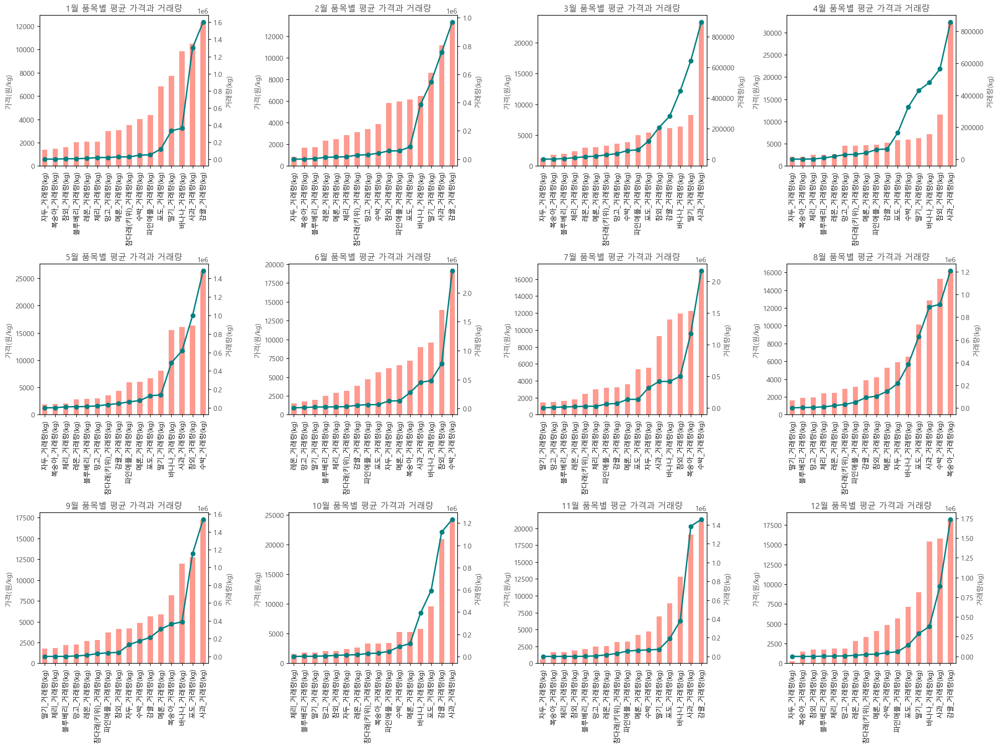

In [22]:
fig, axes = plt.subplots(3, 4, figsize=(20, 15))
axes = axes.flatten()

for month in range(1, 13):
    ax1 = axes[month-1]  # 가격
    ax2 = ax1.twinx()    # 거래량

    df_monthly_means.loc[month, price_cols].sort_values().plot(kind='bar', ax=ax1, color='#FF6F61', alpha=0.7)
    ax1.set_ylabel('가격(원/kg)', color='#4B4B4B')
    ax1.tick_params(axis='y', labelcolor='#4B4B4B')

    df_monthly_means.loc[month, qty_cols].sort_values().plot(kind='line', ax=ax2, color='#008080', marker='o', linestyle='-', linewidth=2)
    ax2.set_ylabel('거래량(kg)', color='#4B4B4B')
    ax2.tick_params(axis='y', labelcolor='#4B4B4B')

    ax1.set_title(f'{month}월 품목별 평균 가격과 거래량', color='#4B4B4B')

plt.tight_layout()
plt.show()

- 품목별 년도별 가격&거래량

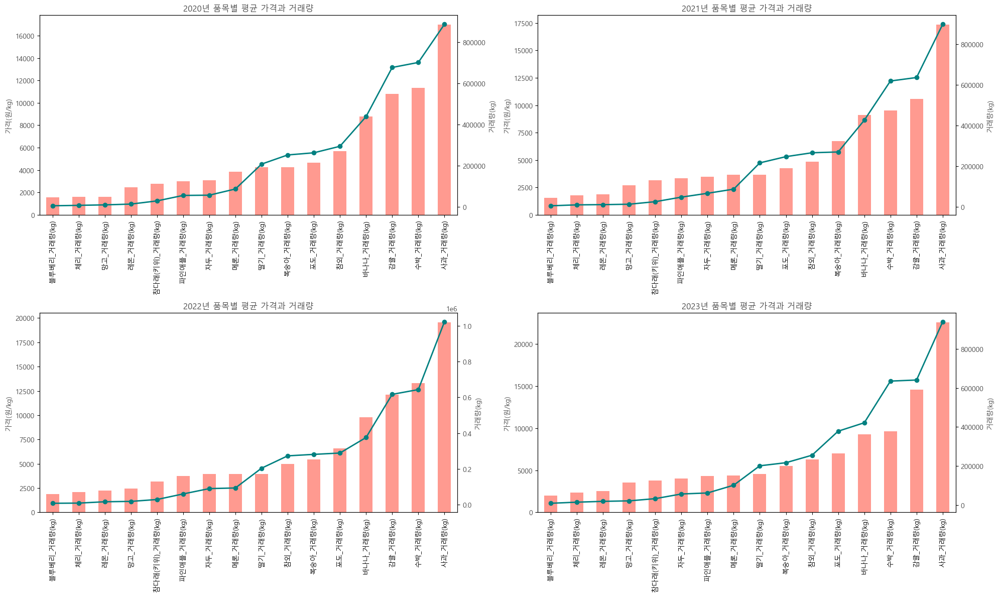

In [23]:
fig, axes = plt.subplots(2, 2, figsize=(20, 12)) 
axes = axes.flatten()

for i, year in enumerate(years):
    ax1 = axes[i]      # 가격
    ax2 = ax1.twinx()  # 거래량

    df_means[year][price_cols].sort_values().plot(kind='bar', ax=ax1, color='#FF6F61', alpha=0.7)
    ax1.set_ylabel('가격(원/kg)', color='#4B4B4B')
    ax1.tick_params(axis='y', labelcolor='#4B4B4B')

    df_means[year][qty_cols].sort_values().plot(kind='line', ax=ax2, color='#008080', marker='o', linestyle='-', linewidth=2)
    ax2.set_ylabel('거래량(kg)', color='#4B4B4B')
    ax2.tick_params(axis='y', labelcolor='#4B4B4B')

    ax1.set_title(f'{year}년 품목별 평균 가격과 거래량', color='#4B4B4B')

plt.tight_layout()
plt.show()

##### 5. 산지별 비교

In [24]:
df = pd.read_csv('../data/fruits.csv')
df

,SALEDATE,WHSAL_NM,CMP_NM,PUM_NM,KIND_NM,DAN_NM,POJ_NM,LV_NM,SAN_NM,DANQ,QTY,COST,TOT_QTY,TOT_AMT
0,2020-12-31,서울가락도매,중앙청과,딸기,설향,kg,상자,특,경상남도 산청군,2.0,15838.0,17338.300290,31676.0,274604000
1,2020-12-31,서울가락도매,중앙청과,딸기,설향,kg,상자,특,충청남도 논산시,1.0,15421.0,9522.404513,15421.0,146845000
2,2020-12-31,부산반여도매,동부청과,딸기,육보,kg,상자,상,부산광역시,2.0,5996.0,30004.000000,11992.0,179903984
3,2020-12-31,서울가락도매,한국청과,딸기,설향,kg,상자,특,충청남도 공주시,2.0,4807.0,14628.562513,9614.0,70319500
4,2020-12-31,구리도매시장,구리청과,딸기,설향,kg,상자,등외,경기 구리시,2.0,4606.0,22562.092922,9212.0,103921000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6698546,2023-01-02,대구북부도매,대구중앙청과,파인애플,파인애플(수입),kg,상자,상,수입산,13.0,12.0,30000.000000,156.0,360000
6698547,2023-01-02,대구북부도매,효성청과,파인애플,파인애플(수입),kg,상자,등외,필리핀,12.0,6.0,31000.000000,72.0,186000
6698548,2023-01-02,대구북부도매,효성청과,파인애플,파인애플(수입),kg,상자,등외,필리핀,13.0,3.0,30000.000000,39.0,90000
6698549,2023-01-02,익산도매시장,익산원협(공),파인애플,기타파인애플,kg,상자,특,전북 완주군,12.0,2.0,27000.000000,24.0,54000


**행정구역**
- 강원도
- 경기도
- 경상북도
- 경상남도
- 전라북도
- 전라남도
- 충청북도
- 충청남도
- 서울특별시
- 세종특별자치시
- 부산광역시
- 대구광역시
- 인천광역시
- 광주광역시
- 대전광역시
- 울산광역시
- 제주특별자치도

In [25]:
# 국내 산지
df = df[df['SAN_NM'].str.contains('군|구|도|시')]
df

,SALEDATE,WHSAL_NM,CMP_NM,PUM_NM,KIND_NM,DAN_NM,POJ_NM,LV_NM,SAN_NM,DANQ,QTY,COST,TOT_QTY,TOT_AMT
0,2020-12-31,서울가락도매,중앙청과,딸기,설향,kg,상자,특,경상남도 산청군,2.0,15838.0,17338.300290,31676.0,274604000
1,2020-12-31,서울가락도매,중앙청과,딸기,설향,kg,상자,특,충청남도 논산시,1.0,15421.0,9522.404513,15421.0,146845000
2,2020-12-31,부산반여도매,동부청과,딸기,육보,kg,상자,상,부산광역시,2.0,5996.0,30004.000000,11992.0,179903984
3,2020-12-31,서울가락도매,한국청과,딸기,설향,kg,상자,특,충청남도 공주시,2.0,4807.0,14628.562513,9614.0,70319500
4,2020-12-31,구리도매시장,구리청과,딸기,설향,kg,상자,등외,경기 구리시,2.0,4606.0,22562.092922,9212.0,103921000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6698529,2023-01-03,익산도매시장,이리청과,파인애플,파인애플(수입),kg,상자,.,전북 익산시,10.0,2.0,27000.000000,20.0,54000
6698533,2023-01-03,정읍도매시장,정읍원협(공),파인애플,기타파인애플,kg,상자,.,광주광역시,12.0,1.0,29040.000000,12.0,29040
6698540,2023-01-02,원주도매시장,원주원협(공),파인애플,기타파인애플,kg,상자,특,서울 송파구,12.0,37.0,28642.162162,444.0,1059760
6698542,2023-01-02,구미도매시장,구미농협(공),파인애플,기타파인애플,kg,파렛트,.,대구광역시,20.0,20.0,27200.000000,400.0,544000


In [26]:
df['SAN_NM'] = df['SAN_NM'].str.replace(r'\b강원\b', '강원도', regex=True)
df['SAN_NM'] = df['SAN_NM'].str.replace(r'\b경기\b', '경기도', regex=True)
df['SAN_NM'] = df['SAN_NM'].str.replace('경남', '경상남도')
df['SAN_NM'] = df['SAN_NM'].str.replace('경북', '경상북도')
df['SAN_NM'] = df['SAN_NM'].str.replace('전남', '전라남도')
df['SAN_NM'] = df['SAN_NM'].str.replace('전북', '전라북도')
df['SAN_NM'] = df['SAN_NM'].str.replace('충남', '충청남도')
df['SAN_NM'] = df['SAN_NM'].str.replace('충북', '충청북도')
df['SAN_NM'] = df['SAN_NM'].str.replace(r'\b서울\b', '서울특별시', regex=True)
df['SAN_NM'] = df['SAN_NM'].str.replace('세종시', '세종특별자치시')
df['SAN_NM'] = df['SAN_NM'].str.replace(r'\b부산\b', '부산광역시', regex=True)
df['SAN_NM'] = df['SAN_NM'].str.replace(r'\b대구\b', '대구광역시', regex=True)
df['SAN_NM'] = df['SAN_NM'].str.replace(r'\b인천\b', '인천광역시', regex=True)
df['SAN_NM'] = df['SAN_NM'].str.replace(r'\b광주\b', '광주광역시', regex=True)
df['SAN_NM'] = df['SAN_NM'].str.replace(r'\b대전\b', '대전광역시', regex=True)
df['SAN_NM'] = df['SAN_NM'].str.replace(r'\b울산\b', '울산광역시', regex=True)
df['SAN_NM'] = df['SAN_NM'].str.replace(r'\b제주\b', '제주특별자치도', regex=True)
df['SAN_NM'] = df['SAN_NM'].str.replace('제주도', '제주특별자치도')

C:\Users\USER\AppData\Local\Temp\ipykernel_126184\43964.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['SAN_NM'] = df['SAN_NM'].str.replace(r'\b강원\b', '강원도', regex=True)
C:\Users\USER\AppData\Local\Temp\ipykernel_126184\43964.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['SAN_NM'] = df['SAN_NM'].str.replace(r'\b경기\b', '경기도', regex=True)
C:\Users\USER\AppData\Local\Temp\ipykernel_126184\43964.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

In [27]:
# '포도', '망고', '체리', '레몬', '블루베리', '수박' ,'딸기', '메론', '사과', '참외', '감귤', '바나나', '복숭아', '참다래(키위)', '자두', '파인애플' 
df_grape = df[df['PUM_NM']=='포도']
df_mango = df[df['PUM_NM']=='망고']
df_cherry = df[df['PUM_NM']=='체리']
df_lemon = df[df['PUM_NM']=='레몬']
df_blueberry = df[df['PUM_NM']=='블루베리']
df_watermelon = df[df['PUM_NM']=='수박']
df_strawberry = df[df['PUM_NM']=='딸기']
df_melon = df[df['PUM_NM']=='메론']
df_apple = df[df['PUM_NM']=='사과']
df_koreanmelon = df[df['PUM_NM']=='참외']
df_mandarin = df[df['PUM_NM']=='감귤']
df_banana = df[df['PUM_NM']=='바나나']
df_peach = df[df['PUM_NM']=='복숭아']
df_kiwi = df[df['PUM_NM']=='참다래(키위)']
df_plum = df[df['PUM_NM']=='자두']
df_pineapple = df[df['PUM_NM']=='파인애플']

품목별로 17개의 주요행정구역별 cost의 평균과 tot_qty의 합으로 나타냄

In [28]:
san_values = [
    '강원도', '경기도', '경상북도', '경상남도', '전라북도', '전라남도',
    '충청북도', '충청남도', '서울특별시', '세종특별자치시', '부산광역시',
    '대구광역시', '인천광역시', '광주광역시', '대전광역시', '울산광역시', '제주특별자치도'
]

def df_fruits(df, san_values):
    san_df = pd.DataFrame({'SAN': san_values})
    mean_costs = []
    tot_qtys = []

    for san in san_values:
        filter_san = df[df['SAN_NM'].str.contains(san)]
        mean_cost = filter_san['COST'].mean()
        tot_qty = filter_san['TOT_QTY'].sum()
        mean_costs.append(mean_cost)
        tot_qtys.append(tot_qty)

    san_df['MEAN_COST'] = mean_costs
    san_df['TOT_QTY'] = tot_qtys
    return san_df

In [29]:
fruits = ['grape', 'mango', 'cherry', 'lemon', 'blueberry', 'watermelon', 'strawberry', 'melon', 
          'apple', 'koreanmelon', 'mandarin', 'banana', 'peach', 'kiwi', 'plum', 'pineapple']
df_dict = {name: globals()[f'df_{name}'] for name in fruits}

fruit_dfs = {name: df_fruits(df, san_values) for name, df in df_dict.items()}

for name, summary_df in fruit_dfs.items():
    print(f"{name} summary:")
    print(summary_df)
    print()

grape summary:
        SAN     MEAN_COST       TOT_QTY
0       강원도  18267.450206  1.799074e+06
1       경기도  24617.853530  2.555674e+07
2      경상북도  18936.772130  1.948024e+08
3      경상남도  15939.695509  1.014567e+07
4      전라북도  18590.045241  2.088320e+07
5      전라남도  20673.661919  3.613393e+06
6      충청북도  17209.019901  2.691856e+07
7      충청남도  17517.407354  8.464473e+06
8     서울특별시  32308.273348  4.116533e+06
9   세종특별자치시  15549.943967  6.775800e+03
10    부산광역시  22671.171676  3.109457e+06
11    대구광역시  20000.163361  5.816620e+06
12    인천광역시  16552.912197  1.478972e+06
13    광주광역시  21752.348416  1.205550e+06
14    대전광역시  17683.780091  3.235866e+06
15    울산광역시  36120.132408  5.374402e+05
16  제주특별자치도  16679.227944  4.121598e+05

mango summary:
        SAN      MEAN_COST   TOT_QTY
0       강원도   36451.225379    5903.0
1       경기도   41640.899123  657892.4
2      경상북도   44506.302427  111546.5
3      경상남도   61685.926479  101055.0
4      전라북도   46223.233508   73504.2
5      전라남도   81477.405522 

In [30]:
for name, df in fruit_dfs.items():
    if 'MEAN_COST' in df.columns:
        fruit_dfs[name]['MEAN_COST'] = df['MEAN_COST'].fillna(0)

In [31]:
for name, summary_df in fruit_dfs.items():
    print(f"{name} summary:")
    print(summary_df)
    print()

grape summary:
        SAN     MEAN_COST       TOT_QTY
0       강원도  18267.450206  1.799074e+06
1       경기도  24617.853530  2.555674e+07
2      경상북도  18936.772130  1.948024e+08
3      경상남도  15939.695509  1.014567e+07
4      전라북도  18590.045241  2.088320e+07
5      전라남도  20673.661919  3.613393e+06
6      충청북도  17209.019901  2.691856e+07
7      충청남도  17517.407354  8.464473e+06
8     서울특별시  32308.273348  4.116533e+06
9   세종특별자치시  15549.943967  6.775800e+03
10    부산광역시  22671.171676  3.109457e+06
11    대구광역시  20000.163361  5.816620e+06
12    인천광역시  16552.912197  1.478972e+06
13    광주광역시  21752.348416  1.205550e+06
14    대전광역시  17683.780091  3.235866e+06
15    울산광역시  36120.132408  5.374402e+05
16  제주특별자치도  16679.227944  4.121598e+05

mango summary:
        SAN      MEAN_COST   TOT_QTY
0       강원도   36451.225379    5903.0
1       경기도   41640.899123  657892.4
2      경상북도   44506.302427  111546.5
3      경상남도   61685.926479  101055.0
4      전라북도   46223.233508   73504.2
5      전라남도   81477.405522 

In [32]:
grape = fruit_dfs['grape']
mango = fruit_dfs['mango']
cherry = fruit_dfs['cherry']
lemon = fruit_dfs['lemon']
blueberry = fruit_dfs['blueberry']
watermelon = fruit_dfs['watermelon']
strawberry = fruit_dfs['strawberry']
melon = fruit_dfs['melon']
apple = fruit_dfs['apple']
koreanmelon = fruit_dfs['koreanmelon']
mandarin = fruit_dfs['mandarin']
banana = fruit_dfs['banana']
peach = fruit_dfs['peach']
kiwi = fruit_dfs['kiwi']
plum = fruit_dfs['plum']
pineapple = fruit_dfs['pineapple']

##### 행정구역별 평균 단가와 거래량 비교

- 포도

C:\Users\USER\AppData\Local\Temp\ipykernel_126184\3791503257.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
C:\Users\USER\AppData\Local\Temp\ipykernel_126184\3791503257.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')


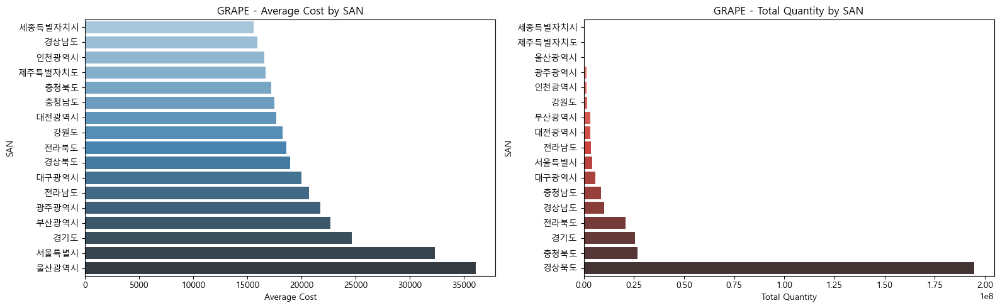

In [33]:
plt.figure(figsize=(16, 5))

grape_cost = grape.sort_values(by='MEAN_COST', ascending=True)
grape_qty = grape.sort_values(by='TOT_QTY', ascending=True)

# MEAN_COST
plt.subplot(1, 2, 1)
sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
plt.title('GRAPE - Average Cost by SAN')
plt.ylabel('SAN')
plt.xlabel('Average Cost')

# TOT_QTY
plt.subplot(1, 2, 2)
sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')
plt.title('GRAPE - Total Quantity by SAN')
plt.ylabel('SAN')
plt.xlabel('Total Quantity')

plt.tight_layout()
plt.show()

- 망고

C:\Users\USER\AppData\Local\Temp\ipykernel_126184\3497742857.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
C:\Users\USER\AppData\Local\Temp\ipykernel_126184\3497742857.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')


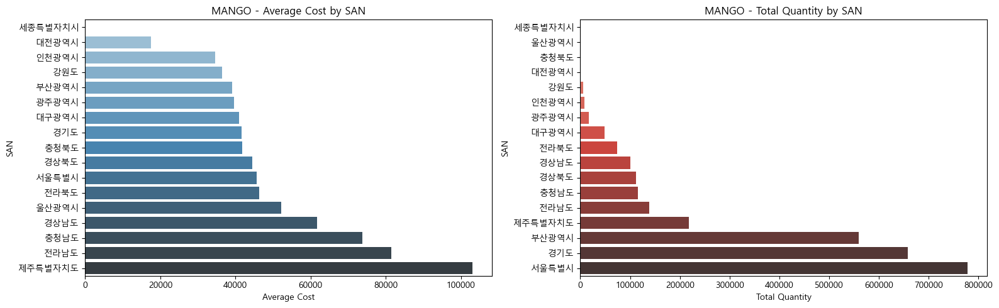

In [34]:
plt.figure(figsize=(16, 5))

grape_cost = mango.sort_values(by='MEAN_COST', ascending=True)
grape_qty = mango.sort_values(by='TOT_QTY', ascending=True)

# MEAN_COST
plt.subplot(1, 2, 1)
sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
plt.title('MANGO - Average Cost by SAN')
plt.ylabel('SAN')
plt.xlabel('Average Cost')

# TOT_QTY
plt.subplot(1, 2, 2)
sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')
plt.title('MANGO - Total Quantity by SAN')
plt.ylabel('SAN')
plt.xlabel('Total Quantity')

plt.tight_layout()
plt.show()

- 체리

C:\Users\USER\AppData\Local\Temp\ipykernel_126184\108515369.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
C:\Users\USER\AppData\Local\Temp\ipykernel_126184\108515369.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')


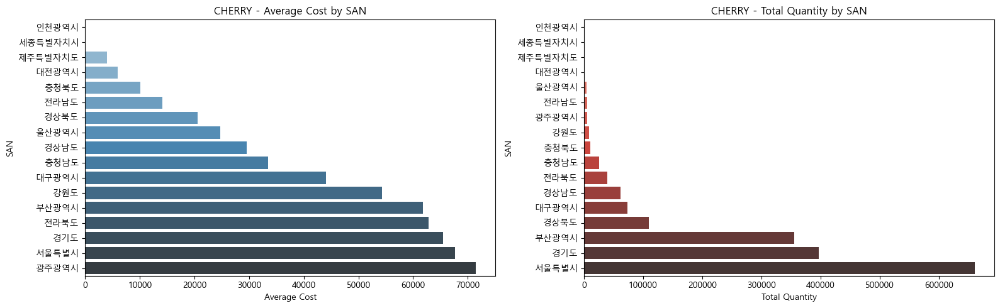

In [35]:
plt.figure(figsize=(16, 5))

grape_cost = cherry.sort_values(by='MEAN_COST', ascending=True)
grape_qty = cherry.sort_values(by='TOT_QTY', ascending=True)

# MEAN_COST
plt.subplot(1, 2, 1)
sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
plt.title('CHERRY - Average Cost by SAN')
plt.ylabel('SAN')
plt.xlabel('Average Cost')

# TOT_QTY
plt.subplot(1, 2, 2)
sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')
plt.title('CHERRY - Total Quantity by SAN')
plt.ylabel('SAN')
plt.xlabel('Total Quantity')

plt.tight_layout()
plt.show()

- 레몬

C:\Users\USER\AppData\Local\Temp\ipykernel_126184\1036456264.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
C:\Users\USER\AppData\Local\Temp\ipykernel_126184\1036456264.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')


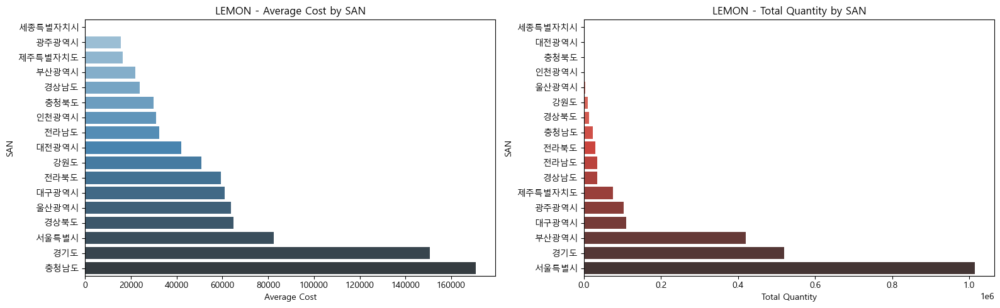

In [36]:
plt.figure(figsize=(16, 5))

grape_cost = lemon.sort_values(by='MEAN_COST', ascending=True)
grape_qty = lemon.sort_values(by='TOT_QTY', ascending=True)

# MEAN_COST
plt.subplot(1, 2, 1)
sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
plt.title('LEMON - Average Cost by SAN')
plt.ylabel('SAN')
plt.xlabel('Average Cost')

# TOT_QTY
plt.subplot(1, 2, 2)
sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')
plt.title('LEMON - Total Quantity by SAN')
plt.ylabel('SAN')
plt.xlabel('Total Quantity')

plt.tight_layout()
plt.show()

- 블루베리

C:\Users\USER\AppData\Local\Temp\ipykernel_126184\1604793109.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
C:\Users\USER\AppData\Local\Temp\ipykernel_126184\1604793109.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')


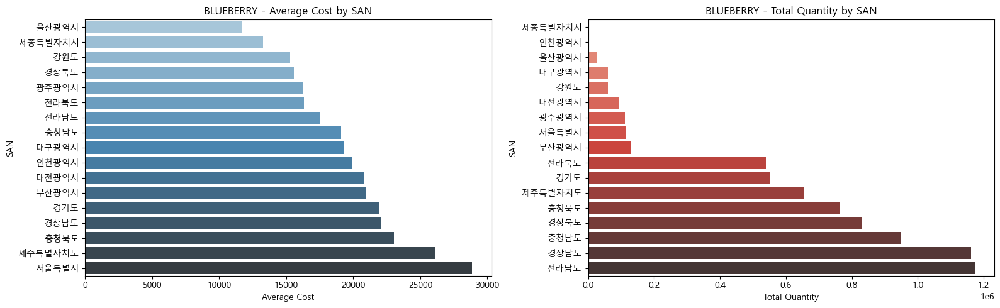

In [37]:
plt.figure(figsize=(16, 5))

grape_cost = blueberry.sort_values(by='MEAN_COST', ascending=True)
grape_qty = blueberry.sort_values(by='TOT_QTY', ascending=True)

# MEAN_COST
plt.subplot(1, 2, 1)
sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
plt.title('BLUEBERRY - Average Cost by SAN')
plt.ylabel('SAN')
plt.xlabel('Average Cost')

# TOT_QTY
plt.subplot(1, 2, 2)
sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')
plt.title('BLUEBERRY - Total Quantity by SAN')
plt.ylabel('SAN')
plt.xlabel('Total Quantity')

plt.tight_layout()
plt.show()

- 수박

C:\Users\USER\AppData\Local\Temp\ipykernel_126184\3632204992.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
C:\Users\USER\AppData\Local\Temp\ipykernel_126184\3632204992.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')


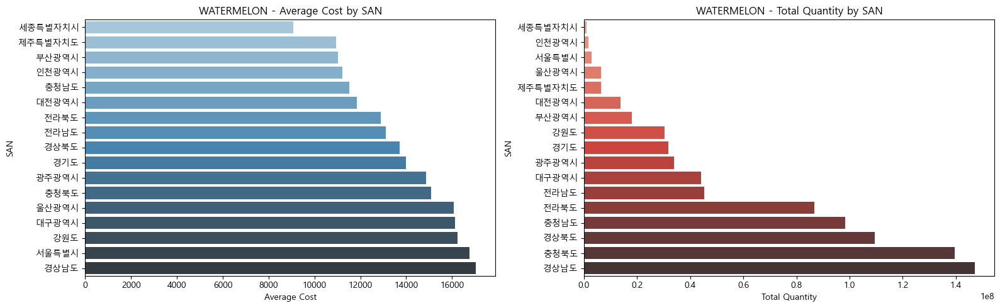

In [38]:
plt.figure(figsize=(16, 5))

grape_cost = watermelon.sort_values(by='MEAN_COST', ascending=True)
grape_qty = watermelon.sort_values(by='TOT_QTY', ascending=True)

# MEAN_COST
plt.subplot(1, 2, 1)
sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
plt.title('WATERMELON - Average Cost by SAN')
plt.ylabel('SAN')
plt.xlabel('Average Cost')

# TOT_QTY
plt.subplot(1, 2, 2)
sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')
plt.title('WATERMELON - Total Quantity by SAN')
plt.ylabel('SAN')
plt.xlabel('Total Quantity')

plt.tight_layout()
plt.show()

- 딸기

C:\Users\USER\AppData\Local\Temp\ipykernel_126184\1243022148.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
C:\Users\USER\AppData\Local\Temp\ipykernel_126184\1243022148.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')


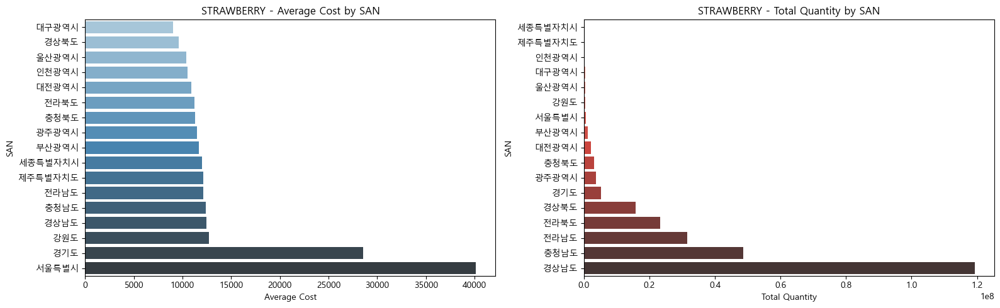

In [39]:
plt.figure(figsize=(16, 5))

grape_cost = strawberry.sort_values(by='MEAN_COST', ascending=True)
grape_qty = strawberry.sort_values(by='TOT_QTY', ascending=True)

# MEAN_COST
plt.subplot(1, 2, 1)
sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
plt.title('STRAWBERRY - Average Cost by SAN')
plt.ylabel('SAN')
plt.xlabel('Average Cost')

# TOT_QTY
plt.subplot(1, 2, 2)
sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')
plt.title('STRAWBERRY - Total Quantity by SAN')
plt.ylabel('SAN')
plt.xlabel('Total Quantity')

plt.tight_layout()
plt.show()

- 메론

C:\Users\USER\AppData\Local\Temp\ipykernel_126184\2177384270.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
C:\Users\USER\AppData\Local\Temp\ipykernel_126184\2177384270.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')


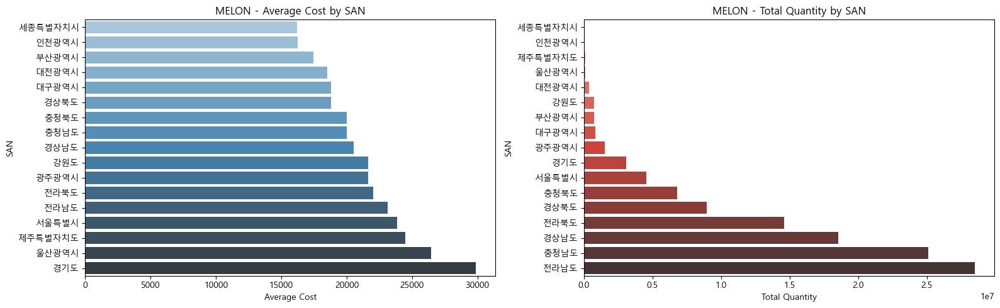

In [40]:
plt.figure(figsize=(16, 5))

grape_cost = melon.sort_values(by='MEAN_COST', ascending=True)
grape_qty = melon.sort_values(by='TOT_QTY', ascending=True)

# MEAN_COST
plt.subplot(1, 2, 1)
sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
plt.title('MELON - Average Cost by SAN')
plt.ylabel('SAN')
plt.xlabel('Average Cost')

# TOT_QTY
plt.subplot(1, 2, 2)
sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')
plt.title('MELON - Total Quantity by SAN')
plt.ylabel('SAN')
plt.xlabel('Total Quantity')

plt.tight_layout()
plt.show()

- 사과

C:\Users\USER\AppData\Local\Temp\ipykernel_126184\824428531.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
C:\Users\USER\AppData\Local\Temp\ipykernel_126184\824428531.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')


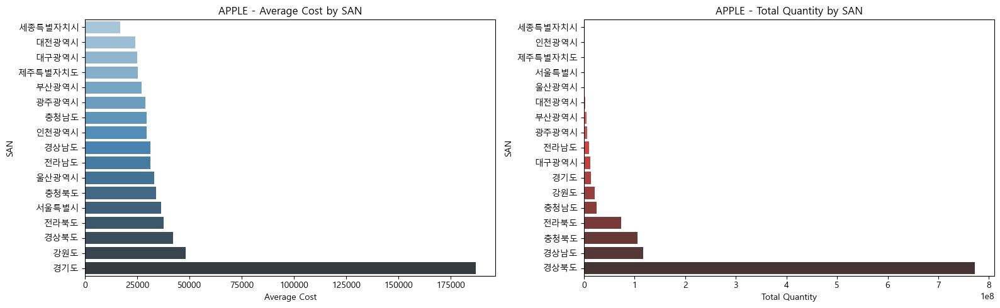

In [41]:
plt.figure(figsize=(16, 5))

grape_cost = apple.sort_values(by='MEAN_COST', ascending=True)
grape_qty = apple.sort_values(by='TOT_QTY', ascending=True)

# MEAN_COST
plt.subplot(1, 2, 1)
sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
plt.title('APPLE - Average Cost by SAN')
plt.ylabel('SAN')
plt.xlabel('Average Cost')

# TOT_QTY
plt.subplot(1, 2, 2)
sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')
plt.title('APPLE - Total Quantity by SAN')
plt.ylabel('SAN')
plt.xlabel('Total Quantity')

plt.tight_layout()
plt.show()

- 참외

C:\Users\USER\AppData\Local\Temp\ipykernel_126184\1168571081.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
C:\Users\USER\AppData\Local\Temp\ipykernel_126184\1168571081.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')


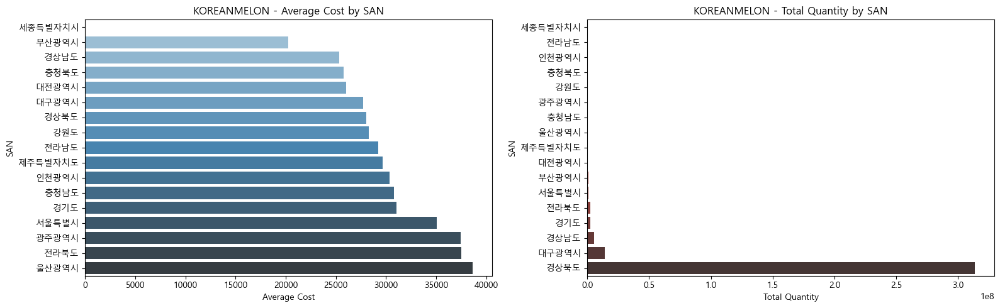

In [42]:
plt.figure(figsize=(16, 5))

grape_cost = koreanmelon.sort_values(by='MEAN_COST', ascending=True)
grape_qty = koreanmelon.sort_values(by='TOT_QTY', ascending=True)

# MEAN_COST
plt.subplot(1, 2, 1)
sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
plt.title('KOREANMELON - Average Cost by SAN')
plt.ylabel('SAN')
plt.xlabel('Average Cost')

# TOT_QTY
plt.subplot(1, 2, 2)
sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')
plt.title('KOREANMELON - Total Quantity by SAN')
plt.ylabel('SAN')
plt.xlabel('Total Quantity')

plt.tight_layout()
plt.show()

- 감귤

C:\Users\USER\AppData\Local\Temp\ipykernel_126184\3893936674.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
C:\Users\USER\AppData\Local\Temp\ipykernel_126184\3893936674.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')


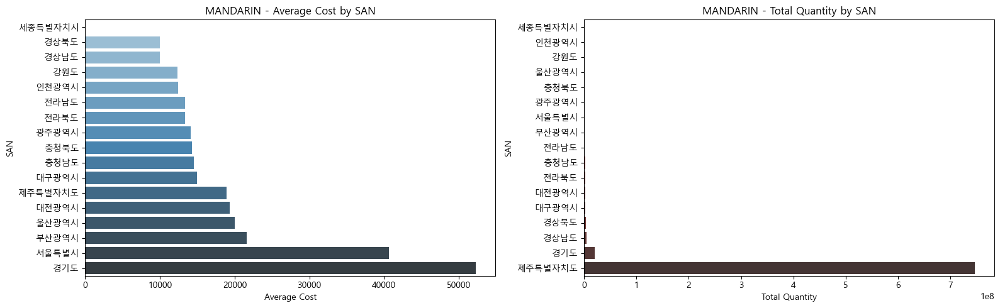

In [43]:
plt.figure(figsize=(16, 5))

grape_cost = mandarin.sort_values(by='MEAN_COST', ascending=True)
grape_qty = mandarin.sort_values(by='TOT_QTY', ascending=True)

# MEAN_COST
plt.subplot(1, 2, 1)
sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
plt.title('MANDARIN - Average Cost by SAN')
plt.ylabel('SAN')
plt.xlabel('Average Cost')

# TOT_QTY
plt.subplot(1, 2, 2)
sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')
plt.title('MANDARIN - Total Quantity by SAN')
plt.ylabel('SAN')
plt.xlabel('Total Quantity')

plt.tight_layout()
plt.show()

- 바나나

C:\Users\USER\AppData\Local\Temp\ipykernel_126184\3911658529.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
C:\Users\USER\AppData\Local\Temp\ipykernel_126184\3911658529.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')


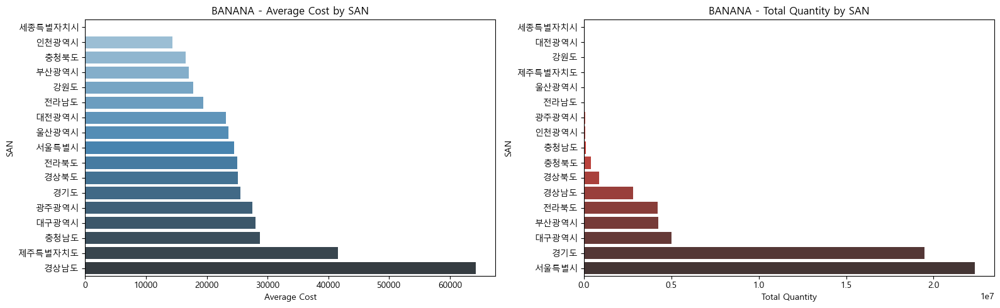

In [44]:
plt.figure(figsize=(16, 5))

grape_cost = banana.sort_values(by='MEAN_COST', ascending=True)
grape_qty = banana.sort_values(by='TOT_QTY', ascending=True)

# MEAN_COST
plt.subplot(1, 2, 1)
sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
plt.title('BANANA - Average Cost by SAN')
plt.ylabel('SAN')
plt.xlabel('Average Cost')

# TOT_QTY
plt.subplot(1, 2, 2)
sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')
plt.title('BANANA - Total Quantity by SAN')
plt.ylabel('SAN')
plt.xlabel('Total Quantity')

plt.tight_layout()
plt.show()

- 복숭아

C:\Users\USER\AppData\Local\Temp\ipykernel_126184\971524742.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
C:\Users\USER\AppData\Local\Temp\ipykernel_126184\971524742.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')


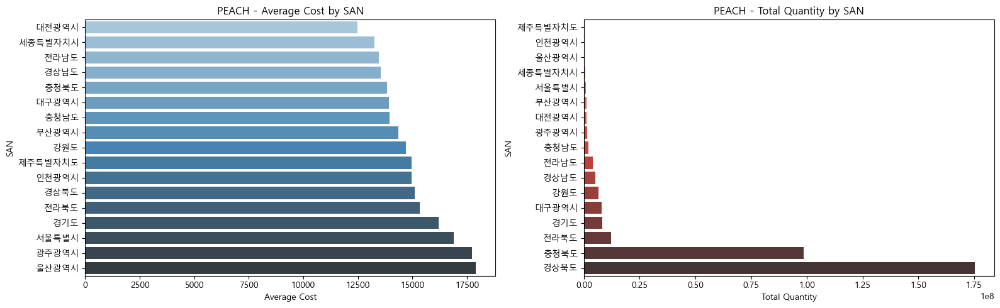

In [45]:
plt.figure(figsize=(16, 5))

grape_cost = peach.sort_values(by='MEAN_COST', ascending=True)
grape_qty = peach.sort_values(by='TOT_QTY', ascending=True)

# MEAN_COST
plt.subplot(1, 2, 1)
sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
plt.title('PEACH - Average Cost by SAN')
plt.ylabel('SAN')
plt.xlabel('Average Cost')

# TOT_QTY
plt.subplot(1, 2, 2)
sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')
plt.title('PEACH - Total Quantity by SAN')
plt.ylabel('SAN')
plt.xlabel('Total Quantity')

plt.tight_layout()
plt.show()

- 키위

C:\Users\USER\AppData\Local\Temp\ipykernel_126184\2685262394.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
C:\Users\USER\AppData\Local\Temp\ipykernel_126184\2685262394.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')


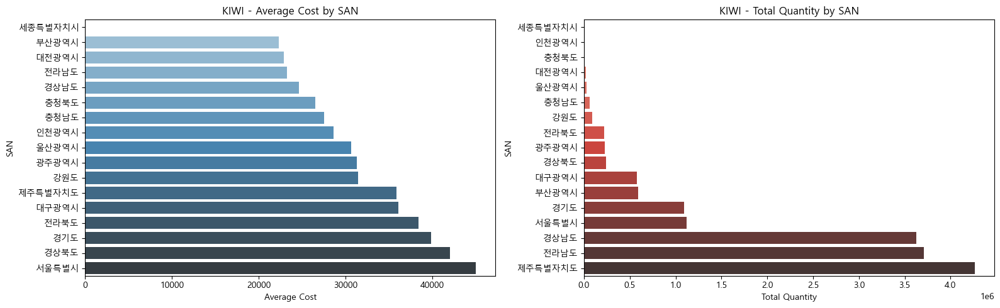

In [46]:
plt.figure(figsize=(16, 5))

grape_cost = kiwi.sort_values(by='MEAN_COST', ascending=True)
grape_qty = kiwi.sort_values(by='TOT_QTY', ascending=True)

# MEAN_COST
plt.subplot(1, 2, 1)
sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
plt.title('KIWI - Average Cost by SAN')
plt.ylabel('SAN')
plt.xlabel('Average Cost')

# TOT_QTY
plt.subplot(1, 2, 2)
sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')
plt.title('KIWI - Total Quantity by SAN')
plt.ylabel('SAN')
plt.xlabel('Total Quantity')

plt.tight_layout()
plt.show()

- 자두

C:\Users\USER\AppData\Local\Temp\ipykernel_126184\1048668930.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
C:\Users\USER\AppData\Local\Temp\ipykernel_126184\1048668930.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')


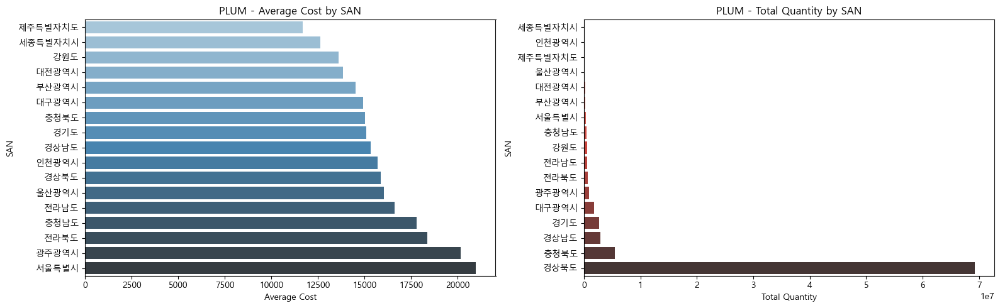

In [47]:
plt.figure(figsize=(16, 5))

grape_cost = plum.sort_values(by='MEAN_COST', ascending=True)
grape_qty = plum.sort_values(by='TOT_QTY', ascending=True)

# MEAN_COST
plt.subplot(1, 2, 1)
sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
plt.title('PLUM - Average Cost by SAN')
plt.ylabel('SAN')
plt.xlabel('Average Cost')

# TOT_QTY
plt.subplot(1, 2, 2)
sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')
plt.title('PLUM - Total Quantity by SAN')
plt.ylabel('SAN')
plt.xlabel('Total Quantity')

plt.tight_layout()
plt.show()

- 파인애플

C:\Users\USER\AppData\Local\Temp\ipykernel_126184\3774815892.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
C:\Users\USER\AppData\Local\Temp\ipykernel_126184\3774815892.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')


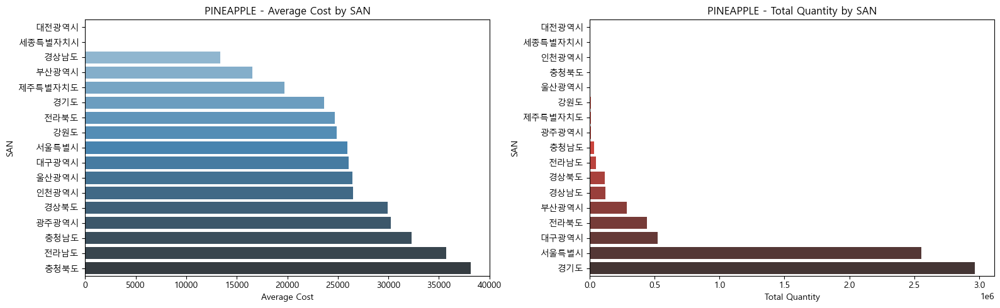

In [48]:
plt.figure(figsize=(16, 5))

grape_cost = pineapple.sort_values(by='MEAN_COST', ascending=True)
grape_qty = pineapple.sort_values(by='TOT_QTY', ascending=True)

# MEAN_COST
plt.subplot(1, 2, 1)
sns.barplot(x='MEAN_COST', y='SAN', data=grape_cost, palette='Blues_d')
plt.title('PINEAPPLE - Average Cost by SAN')
plt.ylabel('SAN')
plt.xlabel('Average Cost')

# TOT_QTY
plt.subplot(1, 2, 2)
sns.barplot(x='TOT_QTY', y='SAN', data=grape_qty, palette='Reds_d')
plt.title('PINEAPPLE - Total Quantity by SAN')
plt.ylabel('SAN')
plt.xlabel('Total Quantity')

plt.tight_layout()
plt.show()

C:\Users\USER\AppData\Local\Temp\ipykernel_126184\2719732035.py:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='MEAN_COST', y='SAN', data=df_sorted_mean_cost, palette='Blues_d', ax=axes[i, 0])
C:\Users\USER\AppData\Local\Temp\ipykernel_126184\2719732035.py:19: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='TOT_QTY', y='SAN', data=df_sorted_tot_qty, palette='Reds_d', ax=axes[i, 1])
C:\Users\USER\AppData\Local\Temp\ipykernel_126184\2719732035.py:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='MEAN_COST', y='SAN', data=df_sorted_mea

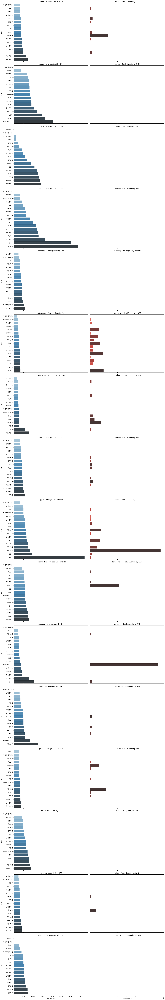

In [49]:
fruits = ['grape', 'mango', 'cherry', 'lemon', 'blueberry', 'watermelon', 'strawberry', 'melon', 
          'apple', 'koreanmelon', 'mandarin', 'banana', 'peach', 'kiwi', 'plum', 'pineapple']

fig, axes = plt.subplots(len(fruits), 2, figsize=(16, len(fruits) * 6), sharex='col', sharey='row')

for i, fruit in enumerate(fruits):
    dfs = fruit_dfs[fruit]
    
    df_sorted_mean_cost = dfs.sort_values(by='MEAN_COST', ascending=True)
    df_sorted_tot_qty = dfs.sort_values(by='TOT_QTY', ascending=True)
    
    # MEAN_COST
    sns.barplot(x='MEAN_COST', y='SAN', data=df_sorted_mean_cost, palette='Blues_d', ax=axes[i, 0])
    axes[i, 0].set_title(f'{fruit} - Average Cost by SAN')
    axes[i, 0].set_xlabel('Average Cost')
    axes[i, 0].set_ylabel('SAN')
    
    # TOT_QTY
    sns.barplot(x='TOT_QTY', y='SAN', data=df_sorted_tot_qty, palette='Reds_d', ax=axes[i, 1])
    axes[i, 1].set_title(f'{fruit} - Total Quantity by SAN')
    axes[i, 1].set_xlabel('Total Quantity')
    axes[i, 1].set_ylabel('SAN')

plt.tight_layout()
plt.show()

##### 6. 산지별 지도표시

In [50]:
state_geo = '../file/TL_SCCO_CTPRVN.json'
state_geo

with open(state_geo, encoding='utf-8') as file:
    sido_map = json.load(file)

sido_map['features'][0]['properties']

{'CTPRVN_CD': '42', 'CTP_ENG_NM': 'Gangwon-do', 'CTP_KOR_NM': '강원도'}

- 포도

In [51]:
grape_m = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=grape,
    columns=['SAN', 'MEAN_COST'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='단가(원/kg)',  
).add_to(grape_m)

grape_m

In [52]:
grape_q = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=grape,
    columns=['SAN', 'TOT_QTY'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='PuBu',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='거래량',  
).add_to(grape_q)

grape_q

- 망고

In [53]:
mango_m = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=mango,
    columns=['SAN', 'MEAN_COST'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='단가(원/kg)',  
).add_to(mango_m)

mango_m

In [54]:
mango_q = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=mango,
    columns=['SAN', 'TOT_QTY'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='PuBu',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='거래량',  
).add_to(mango_q)

mango_q

- 체리

In [55]:
cherry_m = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=cherry,
    columns=['SAN', 'MEAN_COST'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='단가(원/kg)',  
).add_to(cherry_m)

cherry_m

In [56]:
cherry_q = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=cherry,
    columns=['SAN', 'TOT_QTY'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='PuBu',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='거래량',  
).add_to(cherry_q)

cherry_q

- 레몬

In [57]:
lemon_m = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=lemon,
    columns=['SAN', 'MEAN_COST'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='단가(원/kg)',  
).add_to(lemon_m)

lemon_m

In [58]:
lemon_q = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=lemon,
    columns=['SAN', 'TOT_QTY'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='PuBu',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='거래량',  
).add_to(lemon_q)

lemon_q

- 블루베리

In [59]:
blueberry_m = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=blueberry,
    columns=['SAN', 'MEAN_COST'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='단가(원/kg)',  
).add_to(blueberry_m)

blueberry_m

In [60]:
blueberry_q = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=blueberry,
    columns=['SAN', 'TOT_QTY'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='PuBu',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='거래량',  
).add_to(blueberry_q)

blueberry_q

- 수박

In [61]:
watermelon_m = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=watermelon,
    columns=['SAN', 'MEAN_COST'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='단가(원/kg)',  
).add_to(watermelon_m)

watermelon_m

In [62]:
watermelon_q = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=watermelon,
    columns=['SAN', 'TOT_QTY'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='PuBu',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='거래량',  
).add_to(watermelon_q)

watermelon_q

- 딸기

In [63]:
strawberry_m = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=strawberry,
    columns=['SAN', 'MEAN_COST'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='단가(원/kg)',  
).add_to(strawberry_m)

strawberry_m

In [64]:
strawberry_q = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=strawberry,
    columns=['SAN', 'TOT_QTY'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='PuBu',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='거래량',  
).add_to(strawberry_q)

strawberry_q

- 메론

In [65]:
melon_m = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=melon,
    columns=['SAN', 'MEAN_COST'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='단가(원/kg)',  
).add_to(melon_m)

melon_m

In [66]:
melon_q = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=melon,
    columns=['SAN', 'TOT_QTY'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='PuBu',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='거래량',  
).add_to(melon_q)

melon_q

- 사과

In [67]:
apple_m = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=apple,
    columns=['SAN', 'MEAN_COST'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='단가(원/kg)',  
).add_to(apple_m)

apple_m

In [68]:
apple_q = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=apple,
    columns=['SAN', 'TOT_QTY'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='PuBu',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='거래량',  
).add_to(apple_q)

apple_q

- 참외

In [69]:
koreanmelon_m = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=koreanmelon,
    columns=['SAN', 'MEAN_COST'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='단가(원/kg)',  
).add_to(koreanmelon_m)

koreanmelon_m

In [70]:
koreanmelon_q = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=koreanmelon,
    columns=['SAN', 'TOT_QTY'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='PuBu',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='거래량',  
).add_to(koreanmelon_q)

koreanmelon_q

- 감귤

In [71]:
mandarin_m = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=mandarin,
    columns=['SAN', 'MEAN_COST'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='단가(원/kg)',  
).add_to(mandarin_m)

mandarin_m

In [72]:
mandarin_q = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=mandarin,
    columns=['SAN', 'TOT_QTY'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='PuBu',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='거래량',  
).add_to(mandarin_q)

mandarin_q

- 바나나

In [73]:
banana_m = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=banana,
    columns=['SAN', 'MEAN_COST'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='단가(원/kg)',  
).add_to(banana_m)

banana_m

In [74]:
banana_q = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=banana,
    columns=['SAN', 'TOT_QTY'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='PuBu',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='거래량',  
).add_to(banana_q)

banana_q

- 복숭아

In [75]:
peach_m = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=peach,
    columns=['SAN', 'MEAN_COST'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='단가(원/kg)',  
).add_to(peach_m)

peach_m

In [76]:
peach_q = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=peach,
    columns=['SAN', 'TOT_QTY'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='PuBu',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='거래량',  
).add_to(peach_q)

peach_q

- 키위

In [77]:
kiwi_m = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=kiwi,
    columns=['SAN', 'MEAN_COST'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='단가(원/kg)',  
).add_to(kiwi_m)

kiwi_m

In [78]:
kiwi_q = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=kiwi,
    columns=['SAN', 'TOT_QTY'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='PuBu',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='거래량',  
).add_to(kiwi_q)

kiwi_q

- 자두

In [79]:
plum_m = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=plum,
    columns=['SAN', 'MEAN_COST'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='단가(원/kg)',  
).add_to(plum_m)

plum_m

In [80]:
plum_q = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=plum,
    columns=['SAN', 'TOT_QTY'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='PuBu',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='거래량',  
).add_to(plum_q)

plum_q

- 파인애플

In [81]:
pineapple_m = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=pineapple,
    columns=['SAN', 'MEAN_COST'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='단가(원/kg)',  
).add_to(pineapple_m)

pineapple_m

In [82]:
pineapple_q = folium.Map(location=[36, 127.5], zoom_start=7,)

ch = folium.Choropleth(
    geo_data=sido_map,
    name='choropleth',
    data=pineapple,
    columns=['SAN', 'TOT_QTY'], 
    key_on='feature.properties.CTP_KOR_NM',  
    fill_color='PuBu',
    fill_opacity=0.7,
    line_opacity=1,  
    line_weight=1.5,
    line_color='#AAA',
    legend_name='거래량',  
).add_to(pineapple_q)

pineapple_q

품목별 2중축 그래프(mean_cost, tot_qty)

- 포도

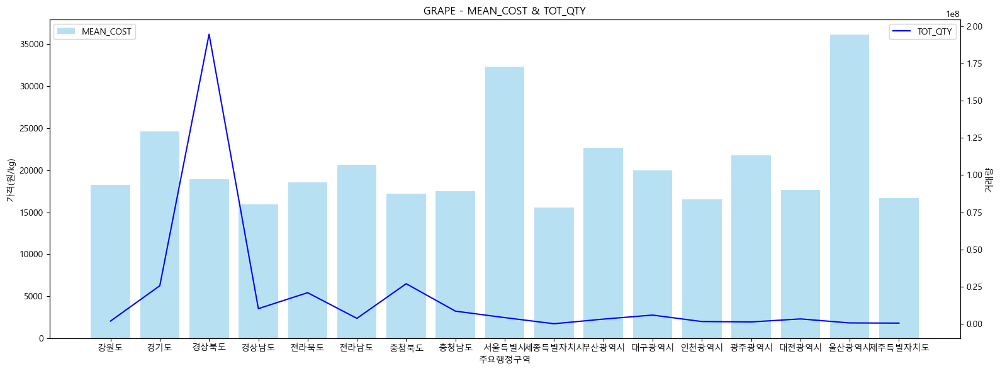

In [83]:
fig, ax1 = plt.subplots(figsize=(16, 6))

x = grape['SAN']

ax1.bar(x, grape['MEAN_COST'], color='skyblue', alpha=0.6, label='MEAN_COST')
ax1.set_xlabel('주요행정구역')
ax1.set_ylabel('가격(원/kg)', color='black')
ax1.tick_params(axis='y', labelcolor='black')

ax2 = ax1.twinx()
ax2.plot(x, grape['TOT_QTY'], color='blue', label='TOT_QTY')
ax2.set_ylabel('거래량', color='black')
ax2.tick_params(axis='y', labelcolor='black')

plt.title('GRAPE - MEAN_COST & TOT_QTY')

ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

- 망고

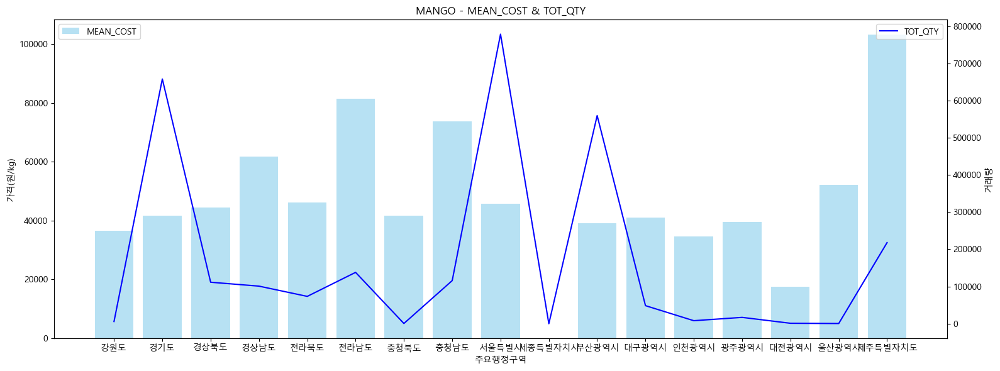

In [84]:
fig, ax1 = plt.subplots(figsize=(16, 6))

x = mango['SAN']

ax1.bar(x, mango['MEAN_COST'], color='skyblue', alpha=0.6, label='MEAN_COST')
ax1.set_xlabel('주요행정구역')
ax1.set_ylabel('가격(원/kg)', color='black')
ax1.tick_params(axis='y', labelcolor='black')

ax2 = ax1.twinx()
ax2.plot(x, mango['TOT_QTY'], color='blue', label='TOT_QTY')
ax2.set_ylabel('거래량', color='black')
ax2.tick_params(axis='y', labelcolor='black')

plt.title('MANGO - MEAN_COST & TOT_QTY')

ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

- 체리

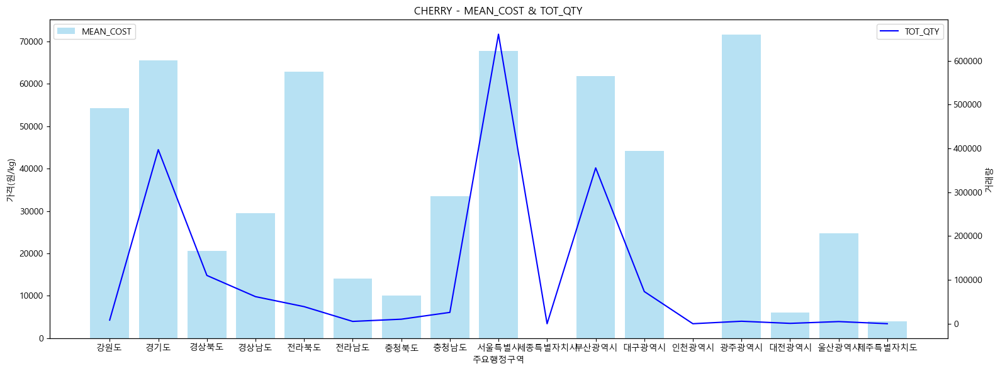

In [85]:
fig, ax1 = plt.subplots(figsize=(16, 6))

x = cherry['SAN']

ax1.bar(x, cherry['MEAN_COST'], color='skyblue', alpha=0.6, label='MEAN_COST')
ax1.set_xlabel('주요행정구역')
ax1.set_ylabel('가격(원/kg)', color='black')
ax1.tick_params(axis='y', labelcolor='black')

ax2 = ax1.twinx()
ax2.plot(x, cherry['TOT_QTY'], color='blue', label='TOT_QTY')
ax2.set_ylabel('거래량', color='black')
ax2.tick_params(axis='y', labelcolor='black')

plt.title('CHERRY - MEAN_COST & TOT_QTY')

ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

- 레몬

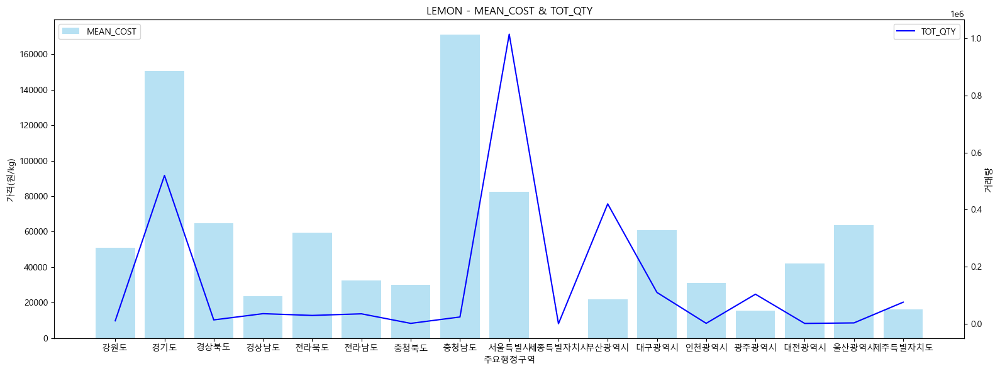

In [86]:
fig, ax1 = plt.subplots(figsize=(16, 6))

x = lemon['SAN']

ax1.bar(x, lemon['MEAN_COST'], color='skyblue', alpha=0.6, label='MEAN_COST')
ax1.set_xlabel('주요행정구역')
ax1.set_ylabel('가격(원/kg)', color='black')
ax1.tick_params(axis='y', labelcolor='black')

ax2 = ax1.twinx()
ax2.plot(x, lemon['TOT_QTY'], color='blue', label='TOT_QTY')
ax2.set_ylabel('거래량', color='black')
ax2.tick_params(axis='y', labelcolor='black')

plt.title('LEMON - MEAN_COST & TOT_QTY')

ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

- 블루베리

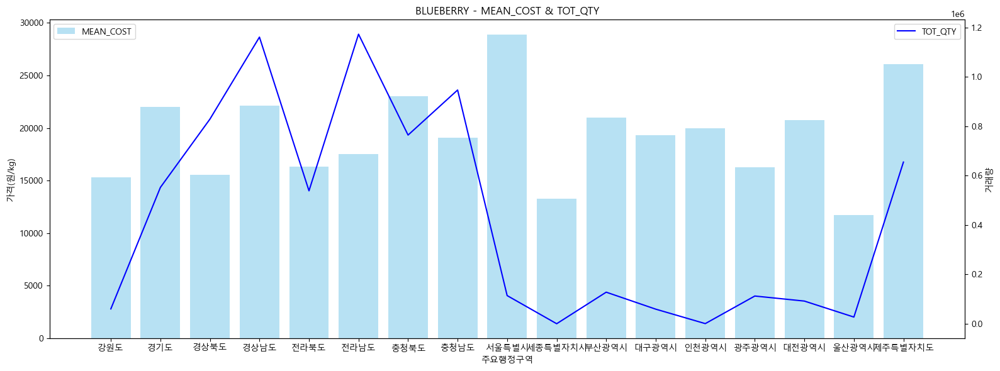

In [87]:
fig, ax1 = plt.subplots(figsize=(16, 6))

x = blueberry['SAN']

ax1.bar(x, blueberry['MEAN_COST'], color='skyblue', alpha=0.6, label='MEAN_COST')
ax1.set_xlabel('주요행정구역')
ax1.set_ylabel('가격(원/kg)', color='black')
ax1.tick_params(axis='y', labelcolor='black')

ax2 = ax1.twinx()
ax2.plot(x, blueberry['TOT_QTY'], color='blue', label='TOT_QTY')
ax2.set_ylabel('거래량', color='black')
ax2.tick_params(axis='y', labelcolor='black')

plt.title('BLUEBERRY - MEAN_COST & TOT_QTY')

ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

- 수박

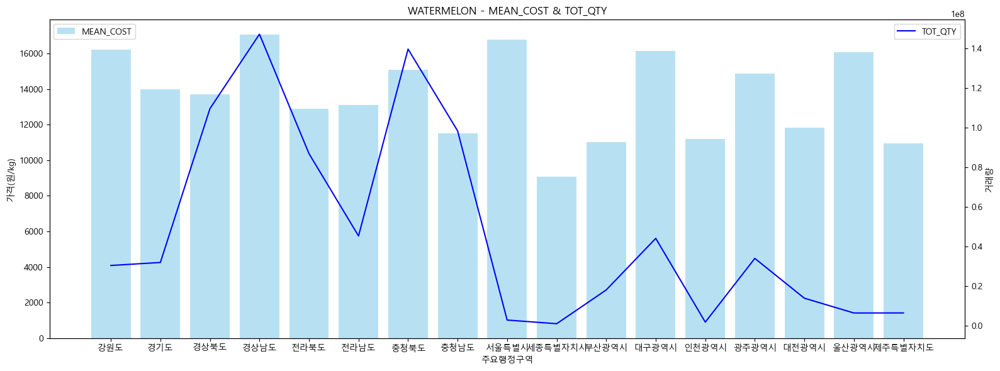

In [88]:
fig, ax1 = plt.subplots(figsize=(16, 6))

x = watermelon['SAN']

ax1.bar(x, watermelon['MEAN_COST'], color='skyblue', alpha=0.6, label='MEAN_COST')
ax1.set_xlabel('주요행정구역')
ax1.set_ylabel('가격(원/kg)', color='black')
ax1.tick_params(axis='y', labelcolor='black')

ax2 = ax1.twinx()
ax2.plot(x, watermelon['TOT_QTY'], color='blue', label='TOT_QTY')
ax2.set_ylabel('거래량', color='black')
ax2.tick_params(axis='y', labelcolor='black')

plt.title('WATERMELON - MEAN_COST & TOT_QTY')

ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

- 딸기

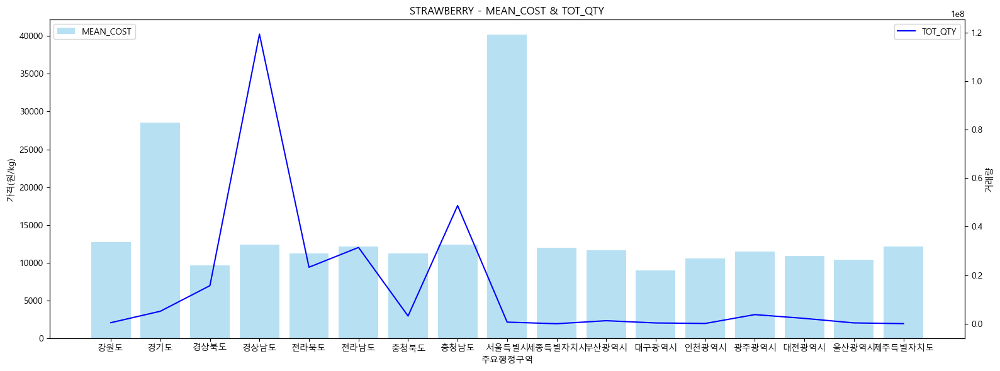

In [89]:
fig, ax1 = plt.subplots(figsize=(16, 6))

x = strawberry['SAN']

ax1.bar(x, strawberry['MEAN_COST'], color='skyblue', alpha=0.6, label='MEAN_COST')
ax1.set_xlabel('주요행정구역')
ax1.set_ylabel('가격(원/kg)', color='black')
ax1.tick_params(axis='y', labelcolor='black')

ax2 = ax1.twinx()
ax2.plot(x, strawberry['TOT_QTY'], color='blue', label='TOT_QTY')
ax2.set_ylabel('거래량', color='black')
ax2.tick_params(axis='y', labelcolor='black')

plt.title('STRAWBERRY - MEAN_COST & TOT_QTY')

ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

- 메론

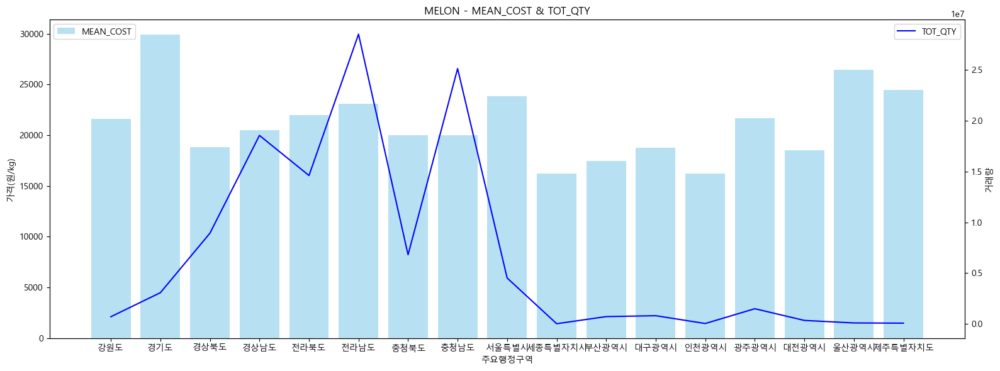

In [90]:
fig, ax1 = plt.subplots(figsize=(16, 6))

x = melon['SAN']

ax1.bar(x, melon['MEAN_COST'], color='skyblue', alpha=0.6, label='MEAN_COST')
ax1.set_xlabel('주요행정구역')
ax1.set_ylabel('가격(원/kg)', color='black')
ax1.tick_params(axis='y', labelcolor='black')

ax2 = ax1.twinx()
ax2.plot(x, melon['TOT_QTY'], color='blue', label='TOT_QTY')
ax2.set_ylabel('거래량', color='black')
ax2.tick_params(axis='y', labelcolor='black')

plt.title('MELON - MEAN_COST & TOT_QTY')

ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

- 사과

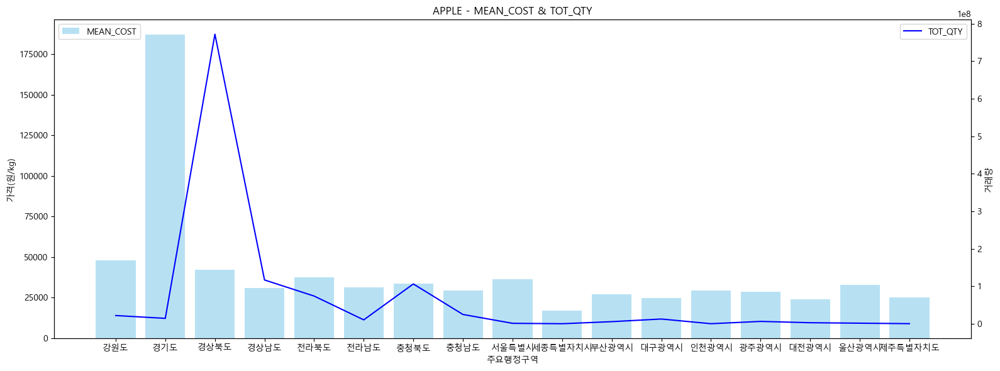

In [91]:
fig, ax1 = plt.subplots(figsize=(16, 6))

x = apple['SAN']

ax1.bar(x, apple['MEAN_COST'], color='skyblue', alpha=0.6, label='MEAN_COST')
ax1.set_xlabel('주요행정구역')
ax1.set_ylabel('가격(원/kg)', color='black')
ax1.tick_params(axis='y', labelcolor='black')

ax2 = ax1.twinx()
ax2.plot(x, apple['TOT_QTY'], color='blue', label='TOT_QTY')
ax2.set_ylabel('거래량', color='black')
ax2.tick_params(axis='y', labelcolor='black')

plt.title('APPLE - MEAN_COST & TOT_QTY')

ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

- 참외

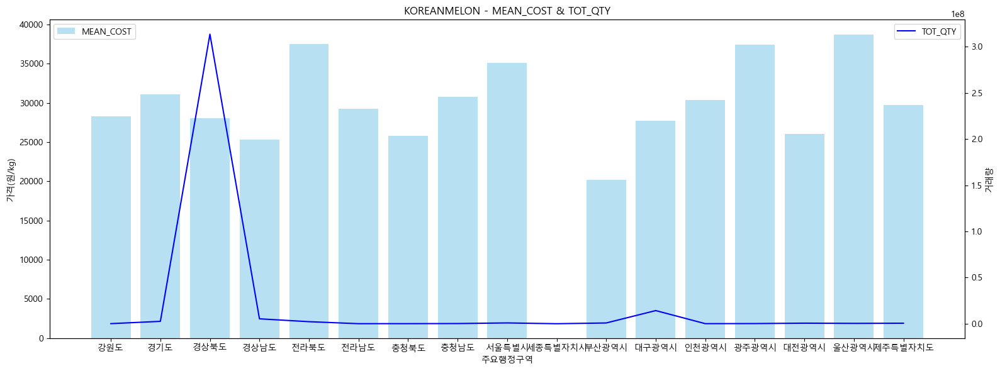

In [92]:
fig, ax1 = plt.subplots(figsize=(16, 6))

x = koreanmelon['SAN']

ax1.bar(x, koreanmelon['MEAN_COST'], color='skyblue', alpha=0.6, label='MEAN_COST')
ax1.set_xlabel('주요행정구역')
ax1.set_ylabel('가격(원/kg)', color='black')
ax1.tick_params(axis='y', labelcolor='black')

ax2 = ax1.twinx()
ax2.plot(x, koreanmelon['TOT_QTY'], color='blue', label='TOT_QTY')
ax2.set_ylabel('거래량', color='black')
ax2.tick_params(axis='y', labelcolor='black')

plt.title('KOREANMELON - MEAN_COST & TOT_QTY')

ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

- 감귤

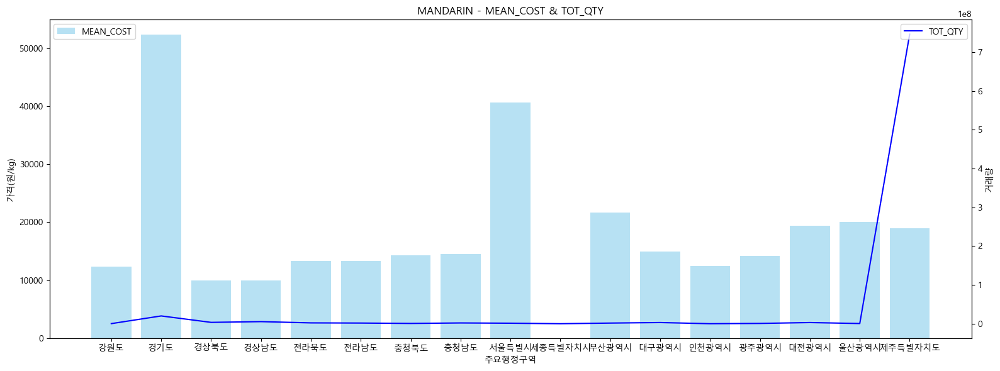

In [93]:
fig, ax1 = plt.subplots(figsize=(16, 6))

x = mandarin['SAN']

ax1.bar(x, mandarin['MEAN_COST'], color='skyblue', alpha=0.6, label='MEAN_COST')
ax1.set_xlabel('주요행정구역')
ax1.set_ylabel('가격(원/kg)', color='black')
ax1.tick_params(axis='y', labelcolor='black')

ax2 = ax1.twinx()
ax2.plot(x, mandarin['TOT_QTY'], color='blue', label='TOT_QTY')
ax2.set_ylabel('거래량', color='black')
ax2.tick_params(axis='y', labelcolor='black')

plt.title('MANDARIN - MEAN_COST & TOT_QTY')

ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

- 바나나

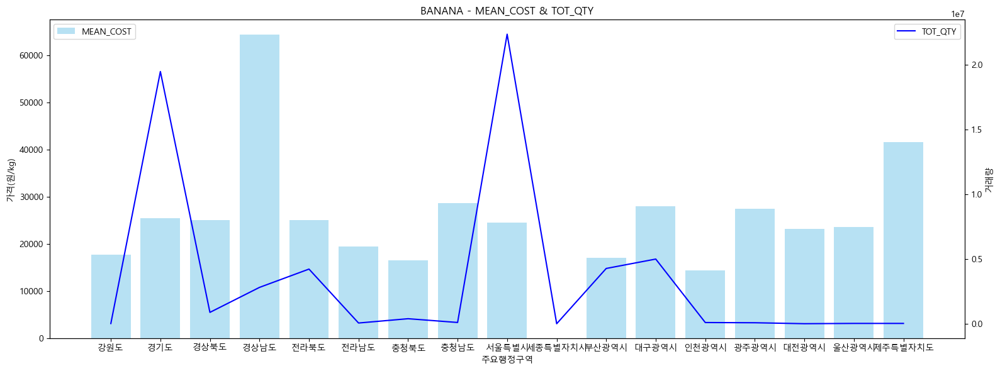

In [94]:
fig, ax1 = plt.subplots(figsize=(16, 6))

x = banana['SAN']

ax1.bar(x, banana['MEAN_COST'], color='skyblue', alpha=0.6, label='MEAN_COST')
ax1.set_xlabel('주요행정구역')
ax1.set_ylabel('가격(원/kg)', color='black')
ax1.tick_params(axis='y', labelcolor='black')

ax2 = ax1.twinx()
ax2.plot(x, banana['TOT_QTY'], color='blue', label='TOT_QTY')
ax2.set_ylabel('거래량', color='black')
ax2.tick_params(axis='y', labelcolor='black')

plt.title('BANANA - MEAN_COST & TOT_QTY')

ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

- 복숭아

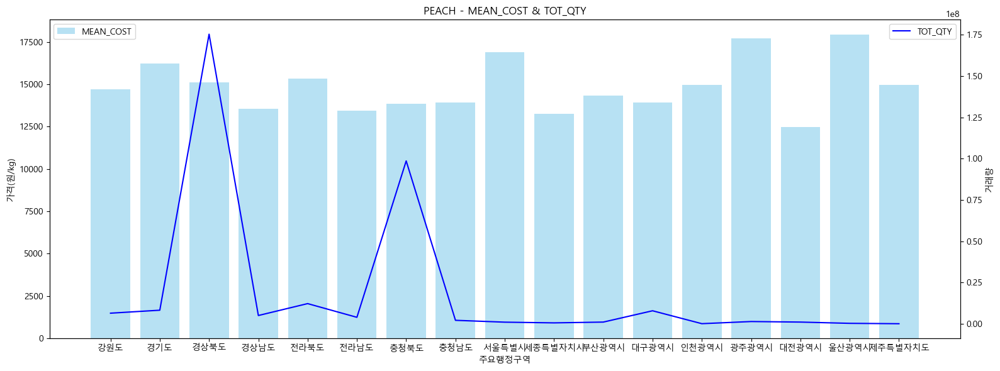

In [95]:
fig, ax1 = plt.subplots(figsize=(16, 6))

x = peach['SAN']

ax1.bar(x, peach['MEAN_COST'], color='skyblue', alpha=0.6, label='MEAN_COST')
ax1.set_xlabel('주요행정구역')
ax1.set_ylabel('가격(원/kg)', color='black')
ax1.tick_params(axis='y', labelcolor='black')

ax2 = ax1.twinx()
ax2.plot(x, peach['TOT_QTY'], color='blue', label='TOT_QTY')
ax2.set_ylabel('거래량', color='black')
ax2.tick_params(axis='y', labelcolor='black')

plt.title('PEACH - MEAN_COST & TOT_QTY')

ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

- 키위

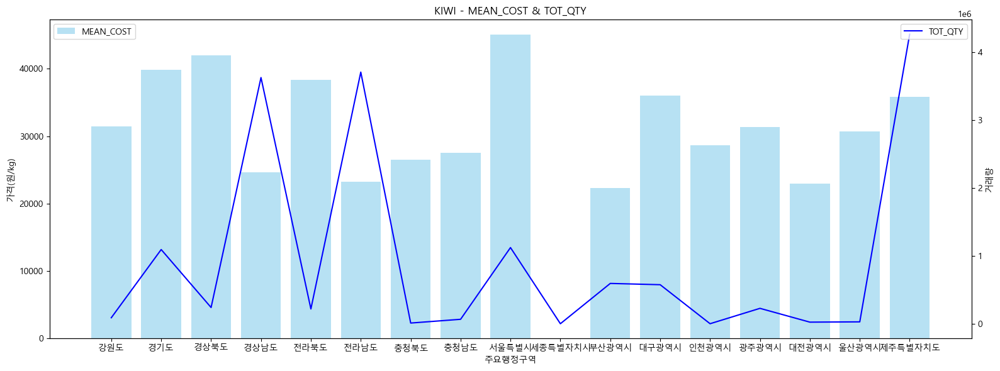

In [96]:
fig, ax1 = plt.subplots(figsize=(16, 6))

x = kiwi['SAN']

ax1.bar(x, kiwi['MEAN_COST'], color='skyblue', alpha=0.6, label='MEAN_COST')
ax1.set_xlabel('주요행정구역')
ax1.set_ylabel('가격(원/kg)', color='black')
ax1.tick_params(axis='y', labelcolor='black')

ax2 = ax1.twinx()
ax2.plot(x, kiwi['TOT_QTY'], color='blue', label='TOT_QTY')
ax2.set_ylabel('거래량', color='black')
ax2.tick_params(axis='y', labelcolor='black')

plt.title('KIWI - MEAN_COST & TOT_QTY')

ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

- 자두

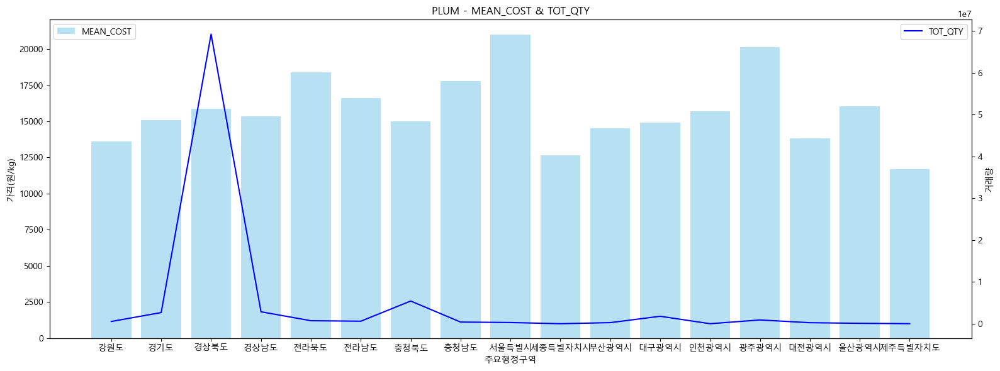

In [97]:
fig, ax1 = plt.subplots(figsize=(16, 6))

x = plum['SAN']

ax1.bar(x, plum['MEAN_COST'], color='skyblue', alpha=0.6, label='MEAN_COST')
ax1.set_xlabel('주요행정구역')
ax1.set_ylabel('가격(원/kg)', color='black')
ax1.tick_params(axis='y', labelcolor='black')

ax2 = ax1.twinx()
ax2.plot(x, plum['TOT_QTY'], color='blue', label='TOT_QTY')
ax2.set_ylabel('거래량', color='black')
ax2.tick_params(axis='y', labelcolor='black')

plt.title('PLUM - MEAN_COST & TOT_QTY')

ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

- 파인애플

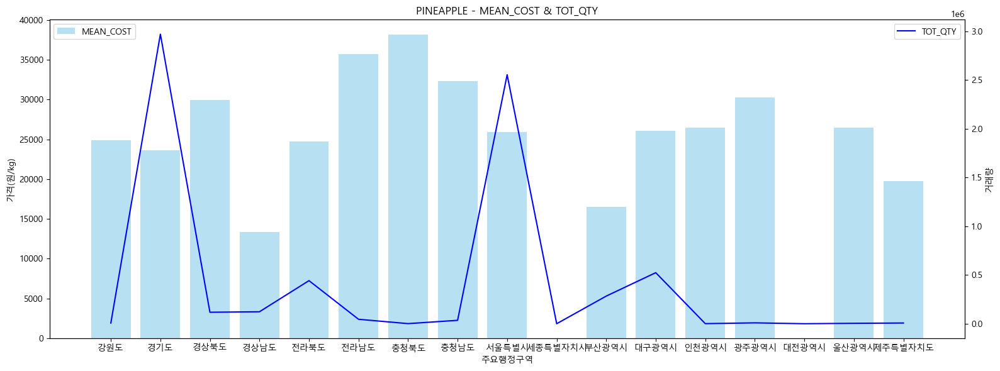

In [98]:
fig, ax1 = plt.subplots(figsize=(16, 6))

x = pineapple['SAN']

ax1.bar(x, pineapple['MEAN_COST'], color='skyblue', alpha=0.6, label='MEAN_COST')
ax1.set_xlabel('주요행정구역')
ax1.set_ylabel('가격(원/kg)', color='black')
ax1.tick_params(axis='y', labelcolor='black')

ax2 = ax1.twinx()
ax2.plot(x, pineapple['TOT_QTY'], color='blue', label='TOT_QTY')
ax2.set_ylabel('거래량', color='black')
ax2.tick_params(axis='y', labelcolor='black')

plt.title('PINEAPPLE - MEAN_COST & TOT_QTY')

ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

주요행정구역별 가장 거래량 많은 품목

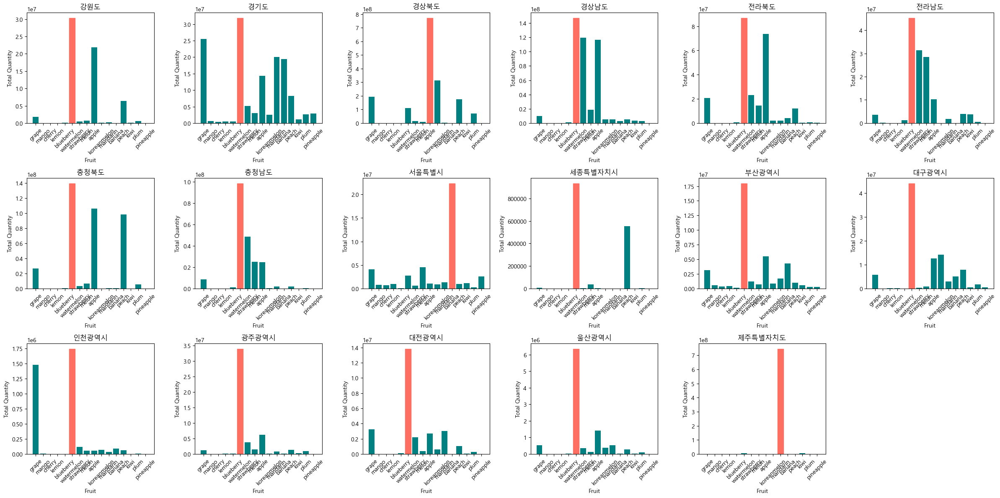

In [99]:
def prepare_data_for_san(fruit_dfs, san_values):
    all_fruit_data = []

    for san in san_values:
        san_data = []
        for name, df in fruit_dfs.items():
            filtered_df = df[df['SAN'] == san]
            if not filtered_df.empty:
                total_qty = filtered_df['TOT_QTY'].sum()
                san_data.append({'Fruit': name, 'Total_Qty': total_qty})

        if san_data:
            san_df = pd.DataFrame(san_data)
            all_fruit_data.append({'SAN': san, 'Data': san_df})

    return all_fruit_data

all_fruit_data = prepare_data_for_san(fruit_dfs, san_values)


fig, axes = plt.subplots(3, 6, figsize=(24, 12))
axes = axes.flatten()

for i, san_info in enumerate(all_fruit_data):
    ax = axes[i]
    san = san_info['SAN']
    san_df = san_info['Data']
    
    bars = ax.bar(san_df['Fruit'], san_df['Total_Qty'], color='#008080')
    
    max_qty = san_df['Total_Qty'].max()
    for bar in bars:
        if bar.get_height() == max_qty:
            bar.set_color('#FF6F61')  # 가장 많이 거래된 과일
    
    ax.set_title(san)
    ax.set_xlabel('Fruit')
    ax.set_ylabel('Total Quantity')
    ax.tick_params(axis='x', rotation=45)

for j in range(len(all_fruit_data), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()